<a href="https://colab.research.google.com/github/fredtush/Data-Presentation-Lab/blob/main/student.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![pump.png](./images/pump.png)



# Pump it Up:  Tanzanian Water Wells(Data Mining the Water Table) 

### HOSTED BY:  DRIVENDATA
### AUTHOR:  FRED MUTUMA


# Business Understanding


They say, "Water is Life". Tanzania is a developing country which has a clean water problem. According to [worldometers.info](https://www.worldometers.info/world-population/tanzania-population/), Tanzania population is 59,353,795 and it has to provide more than 59 million people with clean water. There are many water features which are already well established, but also there are many useless wells or some are in need of repair. 

Drivendata has begun a competition 'Pump It Up' to point this problem. With the predictive model, people can understand which water points are functional, nonfunctional and functional but it needs to repair. This model can help the Tanzanian government to find likely maintenance needy wells or give an useful information for future wells. 

The project's aim is to build a model which tells the status of the water points (as functional, nonfunctional, functional but needs repair). With this model, we will help to the Tanzanian Authorities how to use water sources as a productive way. It also generally helps the both public, private and nn-profit organiszations invest on Tanzania water resources wisely.

# Data Understanding


The original data can be obtained by the [DrivenData 'Pump it Up: Data Mining the Water Table' competition](https://www.drivendata.org/competitions/7/pump-it-up-data-mining-the-water-table/page/23/). Basically, there are 4 different data sets: 
- submission format 
- training set
- test set  
- train labels set which contains status of wells.  

With given training set and labels set, competitors are expected to build a classifier to predict the condition of a water we and apply it to the test set to determine status of the wells and submit. 

In this project, I will use train set and train label set. Train set has 59400 water points data with 40 features. Train labels data has 59400 same water points with train set but just has information about id of these points and status of them.

The data for this comeptition comes from the Taarifa waterpoints dashboard, which aggregates data from the Tanzania Ministry of Water.

In their own words:

Taarifa is an open source platform for the crowd sourced reporting and triaging of infrastructure related issues. Think of it as a bug tracker for the real world which helps to engage citizens with their local government. We are currently working on an Innovation Project in Tanzania, with various partners.

You can learn more here:
Taarifa logo

[Taarifa Homepage]('taarifa.org')
Taarifa Blog
Taarifa Github


### Features

- amount_tsh - Total static head (amount water available to waterpoint)
- date_recorded - The date the row was entered
- funder - Who funded the well
- gps_height - Altitude of the well
- installer - Organization that installed the well
- longitude - GPS coordinate
- latitude - GPS coordinate
- wpt_name - Name of the waterpoint if there is one
- num_private -- 
- basin - Geographic water basin
- subvillage - Geographic location
- region - Geographic location
- region_code - Geographic location (coded)
- district_code - Geographic location (coded)
- lga - Geographic location-
- ward - Geographic location
- population - Population around the well
- public_meeting - True/False
- recorded_by - Group entering this row of data
- scheme_management - Who operates the waterpoint
- scheme_name - Who operates the waterpoint
- permit - If the waterpoint is permitted
- construction_year - Year the waterpoint was constructed
- extraction_type - The kind of extraction the waterpoint uses
- extraction_type_group - The kind of extraction the waterpoint uses
- extraction_type_class - The kind of extraction the waterpoint uses
- management - How the waterpoint is managed
- management_group - How the waterpoint is managed
- payment - What the water costs
- payment_type - What the water costs
- water_quality - The quality of the water
- quality_group - The quality of the water
- quantity - The quantity of water
- quantity_group - The quantity of water
- source - The source of the water
- source_type - The source of the water
- source_class - The source of the water
- waterpoint_type - The kind of waterpoint
- waterpoint_type_group - The kind of waterpoint

## STEP 1:  IMPORTING DATA AND EDA.

In [111]:
# Importing necessary libraries

import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt  
%matplotlib inline        
import seaborn as sns

In [112]:
# Import the training datasets

training_set_df = pd .read_csv('/content/training_set_values.csv')
training_labels_df = pd .read_csv('/content/training_set_labels.csv')

In [113]:
# Viewing the new dataframes 
training_set_df

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,...,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,...,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,...,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,...,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,...,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,...,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59395,60739,10.0,2013-05-03,Germany Republi,1210,CES,37.169807,-3.253847,Area Three Namba 27,0,...,per bucket,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
59396,27263,4700.0,2011-05-07,Cefa-njombe,1212,Cefa,35.249991,-9.070629,Kwa Yahona Kuvala,0,...,annually,soft,good,enough,enough,river,river/lake,surface,communal standpipe,communal standpipe
59397,37057,0.0,2011-04-11,NaN,0,NaN,34.017087,-8.750434,Mashine,0,...,monthly,fluoride,fluoride,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump
59398,31282,0.0,2011-03-08,Malec,0,Musa,35.861315,-6.378573,Mshoro,0,...,never pay,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump


In [114]:
training_labels_df

,id,status_group
0,69572,functional
1,8776,functional
2,34310,functional
3,67743,non functional
4,19728,functional
...,...,...
59395,60739,functional
59396,27263,functional
59397,37057,functional
59398,31282,functional


I then have to merge the two dataframes into one. Using the index to merge them seems appropriate.

In [115]:
# First setting the index for each dataframe to id
training_set_df.set_index('id',inplace=True)
training_labels_df.set_index('id',inplace=True)

# Merging the two dataframes
df = pd.merge(training_set_df, training_labels_df, how = 'inner', left_index = True,right_index=True)

# Set the ne index
df.reset_index(inplace=True)

## A LOOK INTO OUR NEW DATAFRRAME

In [116]:
df

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,...,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,...,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,...,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,...,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,functional
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,...,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,non functional
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,...,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59395,60739,10.0,2013-05-03,Germany Republi,1210,CES,37.169807,-3.253847,Area Three Namba 27,0,...,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
59396,27263,4700.0,2011-05-07,Cefa-njombe,1212,Cefa,35.249991,-9.070629,Kwa Yahona Kuvala,0,...,soft,good,enough,enough,river,river/lake,surface,communal standpipe,communal standpipe,functional
59397,37057,0.0,2011-04-11,NaN,0,NaN,34.017087,-8.750434,Mashine,0,...,fluoride,fluoride,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump,functional
59398,31282,0.0,2011-03-08,Malec,0,Musa,35.861315,-6.378573,Mshoro,0,...,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump,functional


In [117]:
# The dataframe's information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 41 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55765 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59400 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

In [118]:
# The dataframe's dimensions
df.shape

(59400, 41)

In [119]:
#Details and summary of the numerical columns
df.describe()

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,59400.000000,59400.000000,59400.000000,59400.000000,5.940000e+04,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000
mean,37115.131768,317.650385,668.297239,34.077427,-5.706033e+00,0.474141,15.297003,5.629747,179.909983,1300.652475
std,21453.128371,2997.574558,693.116350,6.567432,2.946019e+00,12.236230,17.587406,9.633649,471.482176,951.620547
min,0.000000,0.000000,-90.000000,0.000000,-1.164944e+01,0.000000,1.000000,0.000000,0.000000,0.000000
25%,18519.750000,0.000000,0.000000,33.090347,-8.540621e+00,0.000000,5.000000,2.000000,0.000000,0.000000
50%,37061.500000,0.000000,369.000000,34.908743,-5.021597e+00,0.000000,12.000000,3.000000,25.000000,1986.000000
75%,55656.500000,20.000000,1319.250000,37.178387,-3.326156e+00,0.000000,17.000000,5.000000,215.000000,2004.000000
max,74247.000000,350000.000000,2770.000000,40.345193,-2.000000e-08,1776.000000,99.000000,80.000000,30500.000000,2013.000000


In [120]:
# Investigting the status of the features
df['status_group'].value_counts()

functional                 32259
non functional             22824
functional needs repair     4317
Name: status_group, dtype: int64

In [121]:
# View number of null values in each column
df.isna().sum()

id                           0
amount_tsh                   0
date_recorded                0
funder                    3635
gps_height                   0
installer                 3655
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                 371
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management         3877
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_

## EDA

From the above outputs, there are highly imbalanced target values. Also, there are some null values and some columns which contain same information in the data set. I will drop them because the same values or duplicated values do not affect our target, and when we simplify our data we can run our models easier.

### scheme_management / management / management_group columns

In [122]:
# View frequency of items on scheme_management column
df['scheme_management'].value_counts()

VWC                 36793
WUG                  5206
Water authority      3153
WUA                  2883
Water Board          2748
Parastatal           1680
Private operator     1063
Company              1061
Other                 766
SWC                    97
Trust                  72
None                    1
Name: scheme_management, dtype: int64

In [123]:
# View frequency of items on management column
df['management'].value_counts()

vwc                 40507
wug                  6515
water board          2933
wua                  2535
private operator     1971
parastatal           1768
water authority       904
other                 844
company               685
unknown               561
other - school         99
trust                  78
Name: management, dtype: int64

These two columns has nearly same information. Because scheme_management represents who operates the water point, 'management' represents how the water point is managed. There are 3877 null values in 'scheme_management' column so we prefer 'management' column to keep. The column 'management_group' is also keep similar information that how the water point is managed.

In [124]:
# View frequency of items on management_group column
df['management_group'].value_counts()

user-group    52490
commercial     3638
parastatal     1768
other           943
unknown         561
Name: management_group, dtype: int64

In [125]:
# Finding 'sub-groups' of this column
df.loc[df['management_group']=='user-group']['management'].value_counts() 

vwc            40507
wug             6515
water board     2933
wua             2535
Name: management, dtype: int64

To find the subgroups of 'management_group' column, I checked the 'user-group' values and saw that this column is just the grouped version of 'management'. Although 'management' has more detailed values, I decided to drop 'management_group' column. Also, to remember and check the sub-groups of the 'management_group' column, I grouped it below and saw the numbers of sub-groups (management column).

In [126]:
# View how many sub-groups are present in management_group according to management column
df.groupby(['management_group','management']).count() 

id  amount_tsh  date_recorded  funder  \
management_group management                                                   
commercial       company             685         685            685     663   
                 private operator   1971        1971           1971    1957   
                 trust                78          78             78      78   
                 water authority     904         904            904     836   
other            other               844         844            844     837   
                 other - school       99          99             99      99   
parastatal       parastatal         1768        1768           1768    1624   
unknown          unknown             561         561            561     533   
user-group       vwc               40507       40507          40507   37632   
                 water board        2933        2933           2933    2715   
                 wua                2535        2535           2535    2308   
                 wug                6515        6515           6515    6483   

                                   gps_height  installer  longitude  latitude  \
management_group management                                                     
commercial       company                  685        663        685       685   
                 private operator        1971       1959       1971      1971   
                 trust                     78         78         78        78   
                 water authority          904        836        904       904   
other            other                    844        831        844       844   
                 other - school            99         99         99        99   
parastatal       parastatal              1768       1626       1768      1768   
unknown          unknown                  561        527        561       561   
user-group       vwc                    40507      37630      40507     40507   
                 water board             2933       2714       2933      2933   
                 wua                     2535       2309       2535      2535   
                 wug                     6515       6473       6515      6515   

                                   wpt_name  num_private  ...  water_quality  \
management_group management                               ...                  
commercial       company                685          685  ...            685   
                 private operator      1971         1971  ...           1971   
                 trust                   78           78  ...             78   
                 water authority        904          904  ...            904   
other            other                  844          844  ...            844   
                 other - school          99           99  ...             99   
parastatal       parastatal            1768         1768  ...           1768   
unknown          unknown                561          561  ...            561   
user-group       vwc                  40507        40507  ...          40507   
                 water board           2933         2933  ...           2933   
                 wua                   2535         2535  ...           2535   
                 wug                   6515         6515  ...           6515   

                                   quality_group  quantity  quantity_group  \
management_group management                                                  
commercial       company                     685       685             685   
                 private operator           1971      1971            1971   
                 trust                        78        78              78   
                 water authority             904       904             904   
other            other                       844       844             844   
                 other - school               99        99              99   
parastatal       parastatal                 1768   

### quantity / quantity_group columns

In [127]:
# View frequency of items on quantity column
df['quantity'].value_counts()

enough          33186
insufficient    15129
dry              6246
seasonal         4050
unknown           789
Name: quantity, dtype: int64

In [128]:
# View frequency of items on quantity_group column
df['quantity_group'].value_counts()

enough          33186
insufficient    15129
dry              6246
seasonal         4050
unknown           789
Name: quantity_group, dtype: int64

These two columns contain same information so we decided to drop 'quantity_group' column.

#### Visualise the distribution of the status of a water faeture across the quantity levels

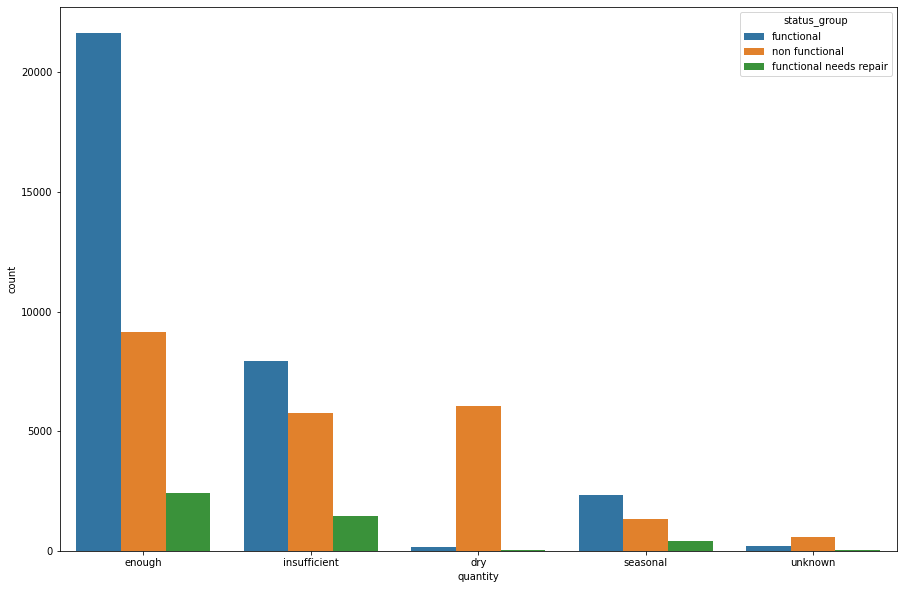

In [129]:
# plot the graph
plt.figure(figsize=(15,10))
ax = sns.countplot(x='quantity', hue="status_group", data=df)
#plt.savefig('./images/fig1.png')

Although there are enough water quantity in some wells, they are non-functional. When looking at this graph, dry quantity water points have a highly correlation with non-functionality. If the water point is dry or unknown, there is high chance thw water point is non functional. On the other hand, if the quantity is enough, there is a higher chance to find functional water points.

### source / source_type / source_class columns

In [130]:
# View frequency of items on source column
df['source'].value_counts()

spring                  17021
shallow well            16824
machine dbh             11075
river                    9612
rainwater harvesting     2295
hand dtw                  874
lake                      765
dam                       656
other                     212
unknown                    66
Name: source, dtype: int64

In [131]:
# View frequency of items on source_type column
df['source_type'].value_counts()

spring                  17021
shallow well            16824
borehole                11949
river/lake              10377
rainwater harvesting     2295
dam                       656
other                     278
Name: source_type, dtype: int64

In [132]:
# View frequency of items on source_class column
df['source_class'].value_counts()

groundwater    45794
surface        13328
unknown          278
Name: source_class, dtype: int64

In [133]:
# View number of sub-groups in source_class according to source column
df.groupby(['source_class','source']).count()

id  amount_tsh  date_recorded  funder  \
source_class source                                                           
groundwater  hand dtw                874         874            874     868   
             machine dbh           11075       11075          11075   10252   
             shallow well          16824       16824          16824   16302   
             spring                17021       17021          17021   15870   
surface      dam                     656         656            656     647   
             lake                    765         765            765     763   
             rainwater harvesting   2295        2295           2295    2099   
             river                  9612        9612           9612    8715   
unknown      other                   212         212            212     204   
             unknown                  66          66             66      45   

                                   gps_height  installer  longitude  latitude  \
source_class source                                                             
groundwater  hand dtw                     874        868        874       874   
             machine dbh                11075      10246      11075     11075   
             shallow well               16824      16286      16824     16824   
             spring                     17021      15870      17021     17021   
surface      dam                          656        646        656       656   
             lake                         765        762        765       765   
             rainwater harvesting        2295       2096       2295      2295   
             river                       9612       8721       9612      9612   
unknown      other                        212        204        212       212   
             unknown                       66         46         66        66   

                                   wpt_name  num_private  ...  payment  \
source_class source                                       ...            
groundwater  hand dtw                   874          874  ...      874   
             machine dbh              11075        11075  ...    11075   
             shallow well             16824        16824  ...    16824   
             spring                   17021        17021  ...    17021   
surface      dam                        656          656  ...      656   
             lake                       765          765  ...      765   
             rainwater harvesting      2295         2295  ...     2295   
             river                     9612         9612  ...     9612   
unknown      other                      212          212  ...      212   
             unknown                     66           66  ...       66   

                                   payment_type  water_quality  quality_group  \
source_class source                                                             
groundwater  hand dtw                       874            874            874   
             machine dbh                  11075          11075          11075   
             shallow well                 16824          16824          16824   
             spring                       17021          17021          17021   
surface      dam                            656            656            656   
             lake                           765            765            765   
             rainwater harvesting          2295           2295           2295   
             river                         9612           9612           9612   
unknown      other                          212            212            212   
             unknown                         66             66             66   

                                   quantity  quantity_group  source_type  \
source_class source                                                        
groundwater  hand dtw                   874             874          874   
             machine dbh  

It is best to keep just 'source' column, because it has more detailed information and we will drop others.

#### Visualise the distribution of the status of a water faeture across the source_class

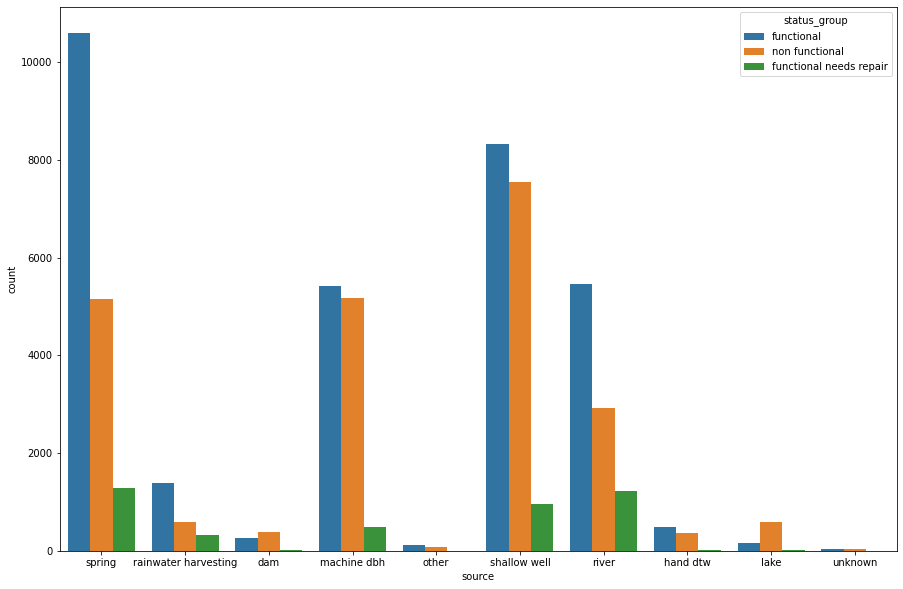

In [134]:
# Plot the graph
plt.figure(figsize=(15,10))
ax = sns.countplot(x='source', hue="status_group", data=df)
# plt.savefig('./images/fig2.png')

When you look at the columns, there are lots of non-functional ground water. Also very notable observations are machine dbh and shallow well sources nearly have same functional and non-functional waterpoints.

#### water_quality / quality_group columns

In [135]:
# View frequency of items on water_quality column
df['water_quality'].value_counts()

soft                  50818
salty                  4856
unknown                1876
milky                   804
coloured                490
salty abandoned         339
fluoride                200
fluoride abandoned       17
Name: water_quality, dtype: int64

In [136]:
# View frequency of items on quality_group column
df['quality_group'].value_counts()

good        50818
salty        5195
unknown      1876
milky         804
colored       490
fluoride      217
Name: quality_group, dtype: int64

'water_quality' column has more unique values, so we will keep 'water_quality' and drop 'quality_group'.

#### Visualise the distribution of the status of a water faeture across the water_quality

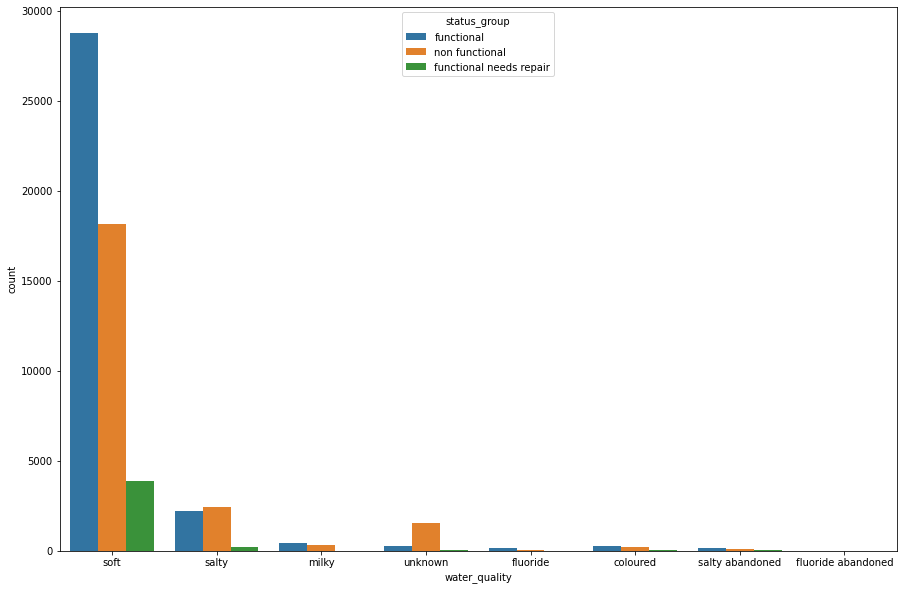

In [137]:
# Plot graph
plt.figure(figsize=(15,10))
ax = sns.countplot(x='water_quality', hue="status_group", data=df)
# plt.savefig('./images/fig3.png')

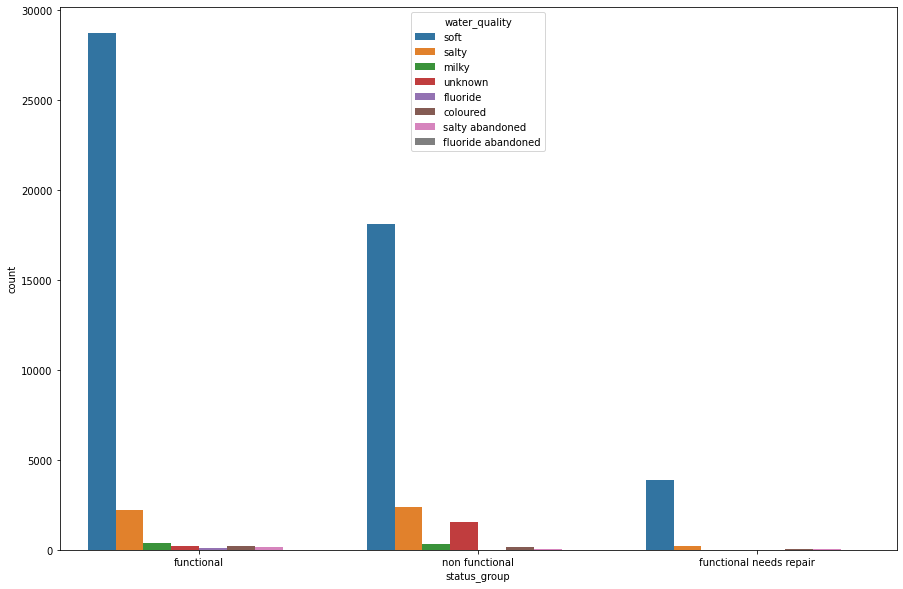

In [138]:
# Plot a graph
plt.figure(figsize=(15,10))
ax = sns.countplot(x='status_group', hue="water_quality", data=df)
# plt.savefig('./images/fig4.png')

From the graphs, it is seen that lots of non-functional water points have soft, good water quality.

### payment / payment_type columns


In [139]:
# View frequency of items on payment column
df['payment'].value_counts()

never pay                25348
pay per bucket            8985
pay monthly               8300
unknown                   8157
pay when scheme fails     3914
pay annually              3642
other                     1054
Name: payment, dtype: int64

In [140]:
# View frequency of items on payment_type column
df['payment_type'].value_counts()

never pay     25348
per bucket     8985
monthly        8300
unknown        8157
on failure     3914
annually       3642
other          1054
Name: payment_type, dtype: int64

Here I can drop either as they are similar. I'll go for payment_type

#### Visualise the distribution of the status of a water faeture across payment

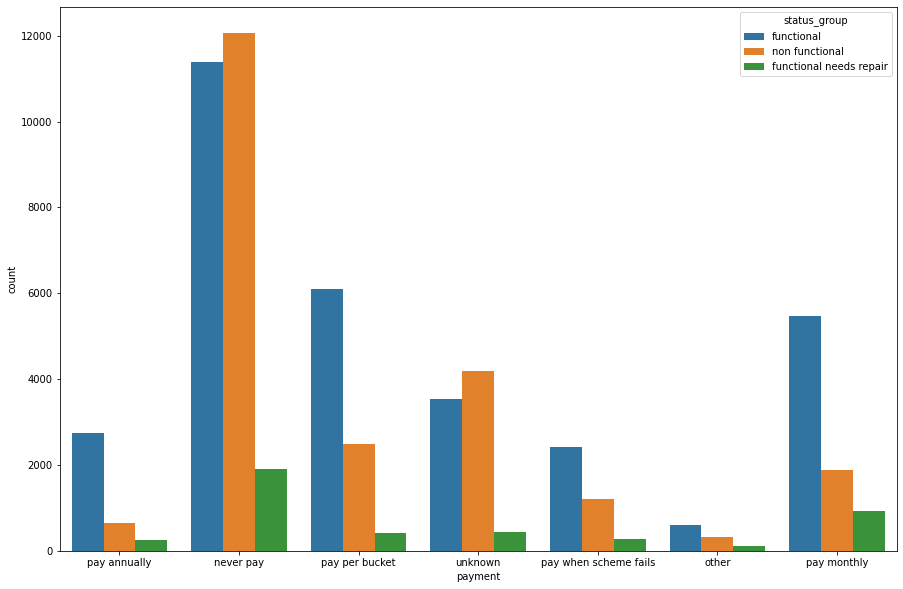

In [141]:
# Plot a graph
plt.figure(figsize=(15,10))
ax = sns.countplot(x='payment', hue="status_group", data=df)
# plt.savefig('./images/fig5.png')

This feature shows us what the water cost. Mostly, there are lots of non-functioal water points as never paid for them.

### extraction_type / extraction_type_group / extraction_type_class columns


In [142]:
# View frequency of items on extraction_type column
df['extraction_type'].value_counts()

gravity                      26780
nira/tanira                   8154
other                         6430
submersible                   4764
swn 80                        3670
mono                          2865
india mark ii                 2400
afridev                       1770
ksb                           1415
other - rope pump              451
other - swn 81                 229
windmill                       117
india mark iii                  98
cemo                            90
other - play pump               85
walimi                          48
climax                          32
other - mkulima/shinyanga        2
Name: extraction_type, dtype: int64

In [143]:
# View frequency of items on extraction_type_group column
df['extraction_type_group'].value_counts()

gravity            26780
nira/tanira         8154
other               6430
submersible         6179
swn 80              3670
mono                2865
india mark ii       2400
afridev             1770
rope pump            451
other handpump       364
other motorpump      122
wind-powered         117
india mark iii        98
Name: extraction_type_group, dtype: int64

In [144]:
# View frequency of items on extraction_type_class column
df['extraction_type_class'].value_counts()

gravity         26780
handpump        16456
other            6430
submersible      6179
motorpump        2987
rope pump         451
wind-powered      117
Name: extraction_type_class, dtype: int64

In [145]:
# VView number of  sub-groups in extraction_type_clas according to extraction_type_group
df.groupby(['extraction_type_class','extraction_type_group']).count()

id  amount_tsh  date_recorded  \
extraction_type_class extraction_type_group                                     
gravity               gravity                26780       26780          26780   
handpump              afridev                 1770        1770           1770   
                      india mark ii           2400        2400           2400   
                      india mark iii            98          98             98   
                      nira/tanira             8154        8154           8154   
                      other handpump           364         364            364   
                      swn 80                  3670        3670           3670   
motorpump             mono                    2865        2865           2865   
                      other motorpump          122         122            122   
other                 other                   6430        6430           6430   
rope pump             rope pump                451         451            451   
submersible           submersible             6179        6179           6179   
wind-powered          wind-powered             117         117            117   

                                             funder  gps_height  installer  \
extraction_type_class extraction_type_group                                  
gravity               gravity                 24704       26780      24714   
handpump              afridev                  1668        1770       1665   
                      india mark ii            2358        2400       2358   
                      india mark iii             98          98         98   
                      nira/tanira              7899        8154       7885   
                      other handpump            353         364        354   
                      swn 80                   3596        3670       3593   
motorpump             mono                     2577        2865       2578   
                      other motorpump           122         122        122   
other                 other                    6010        6430       6002   
rope pump             rope pump                 448         451        448   
submersible           submersible              5820        6179       5816   
wind-powered          wind-powered              112         117        112   

                                             longitude  latitude  wpt_name  \
extraction_type_class extraction_type_group                                  
gravity               gravity                    26780     26780     26780   
handpump              afridev                     1770      1770      1770   
                      india mark ii               2400      2400      2400   
                      india mark iii                98        98        98   
                      nira/tanira                 8154      8154      8154   
                      other handpump               364       364       364   
                      swn 80                      3670      3670      3670   
motorpump             mono                        2865      2865      2865   
                      other motorpump              122       122       122   
other                 other                       6430      6430      6430   
rope pump             rope pump                    451       451       451   
submersible           submersible                 6179      6179      6179   
wind-powered          wind-powered                 117       117       117   

                                             num_private  ...  water_quality  \
extraction_type_class extraction_type_group               ...                  
gravity               gravity                      26780  ...          26780   
handpump              afridev                       1770  ...           1770   
                      india mark ii                 2400  ...           2400   
                      india mark iii                  98  ...             98   
          

It is seen that these three columns keep same information. I decided to keep 'extraction_type_group' and drop others. Although, extraction_type has more unique values than extraction_type_group , some of these values are very small amount according to this big dataset. I opted to use more compact one. Also, extraction_type_class contains much less detail. Therefore, extraction_type_group has to be kept.


#### Visualise the distribution of the status of a water feature across extraction_type_class & extraction_type_group

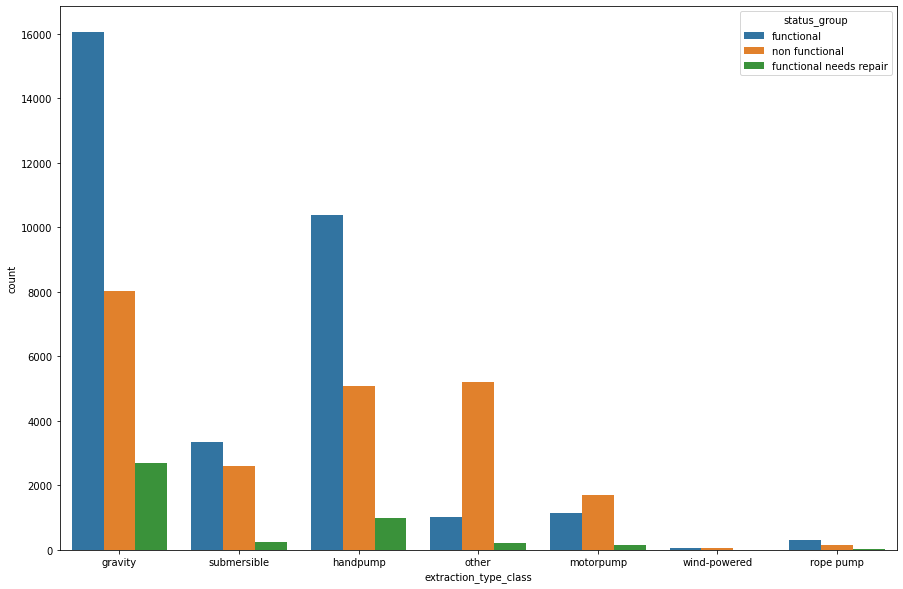

In [146]:
# Plot a graph
plt.figure(figsize=(15,10))
ax = sns.countplot(x='extraction_type_class', hue="status_group", data=df)
# plt.savefig('./images/fig6.png')

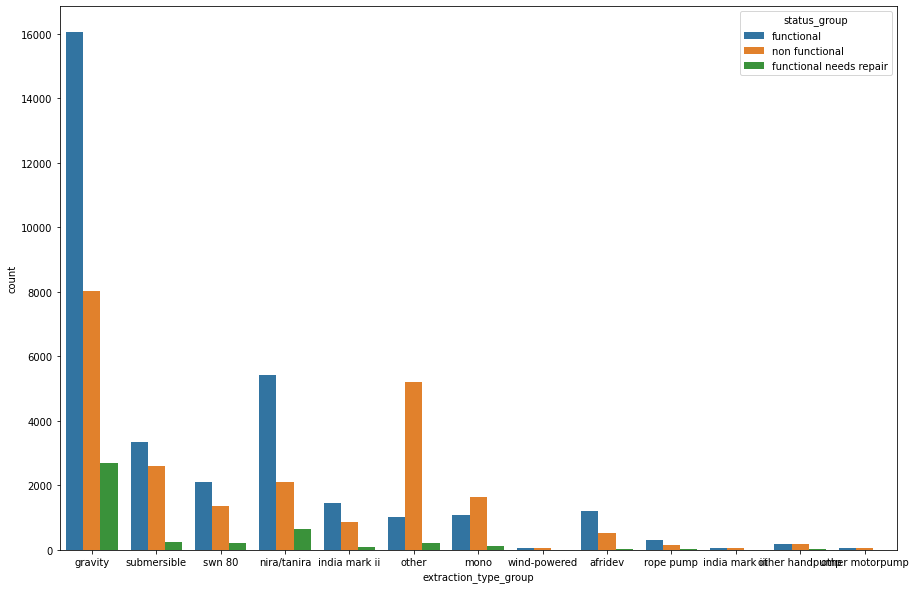

In [147]:
# Plot a graph
plt.figure(figsize=(15,10))
ax = sns.countplot(x='extraction_type_group', hue="status_group", data=df)
# plt.savefig('./images/fig7.png')

Motor_pump, other and mono extraction types have higher change to be non-functional than functional.

### waterpoint_type / waterpoint_type_group

In [148]:
# View frequency of items on waterpoint_type column
df['waterpoint_type'].value_counts()

communal standpipe             28522
hand pump                      17488
other                           6380
communal standpipe multiple     6103
improved spring                  784
cattle trough                    116
dam                                7
Name: waterpoint_type, dtype: int64

In [149]:
# View frequency of items on waterpoint_type_group column
df['waterpoint_type_group'].value_counts()

communal standpipe    34625
hand pump             17488
other                  6380
improved spring         784
cattle trough           116
dam                       7
Name: waterpoint_type_group, dtype: int64

Kept 'waterpoint_type' which contains more detail.

####  Visualise the distribution of the status of a water feature across waterpoint_type

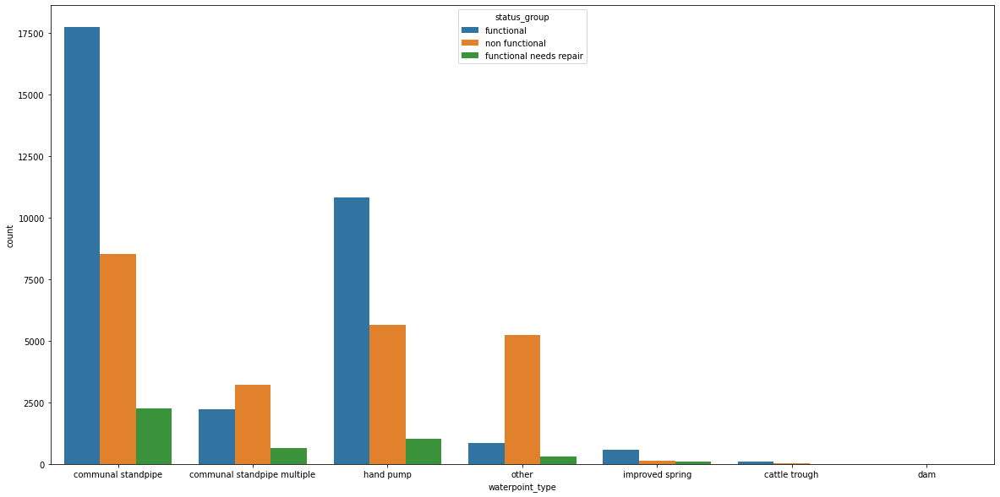

In [150]:
plt.figure(figsize=(20,10))
ax = sns.countplot(x='waterpoint_type', hue="status_group", data=df)
# plt.savefig('./images/fig8.png')

It can be seen that waterpoint type has correlation with funtionality of water points. Such that, communal standpipe has higher possibility to have functional, although communal standpipe multiple and others have higher possibility for non-functionality.

# Dropping Similar Columns

In [151]:
df.drop(columns=['management_group','scheme_management','quantity_group','source_class','source_type',
                 'quality_group','payment_type','extraction_type_class','extraction_type', 
                 'waterpoint_type_group'],inplace=True )



# More EDA

Further check the data for  unnecessary or wrong values.

### construction_year column

In [152]:
# View frequency of items on construction_year column
df['construction_year'].value_counts()

0       20709
2010     2645
2008     2613
2009     2533
2000     2091
2007     1587
2006     1471
2003     1286
2011     1256
2004     1123
2012     1084
2002     1075
1978     1037
1995     1014
2005     1011
1999      979
1998      966
1990      954
1985      945
1980      811
1996      811
1984      779
1982      744
1994      738
1972      708
1974      676
1997      644
1992      640
1993      608
2001      540
1988      521
1983      488
1975      437
1986      434
1976      414
1970      411
1991      324
1989      316
1987      302
1981      238
1977      202
1979      192
1973      184
2013      176
1971      145
1960      102
1967       88
1963       85
1968       77
1969       59
1964       40
1962       30
1961       21
1965       19
1966       17
Name: construction_year, dtype: int64

A new feature is added to the dataset. The year values are converted to decades for future encoding. Zero shows the missing values. They are the majority in the data set therefore, it will not be changed to the mean or median, but kept as a new value in decades.



In [153]:
# Creat the new column
df['decade'] = df['construction_year'] 

# Dividing the column into decades

df['decade'].replace(to_replace = (1960,1961,1962,1963,1964,1965,1966,1967,1968,1969),
                        value ='60s' , inplace=True)
df['decade'].replace(to_replace = (1970,1971,1972,1973,1974,1975,1976,1977,1978,1979),
                        value ='70s' , inplace=True)
df['decade'].replace(to_replace = (1980,1981,1982,1983,1984,1985,1986,1987,1988,1989),
                        value ='80s' , inplace=True)
df['decade'].replace(to_replace = (1990,1991,1992,1993,1994,1995,1996,1997,1998,1999),
                        value ='90s' , inplace=True)
df['decade'].replace(to_replace = (2000,2001,2002,2003,2004,2005,2006,2007,2008,2009),
                        value ='00s' , inplace=True)
df['decade'].replace(to_replace = (2010,2011,2012,2013),
                        value ='10s' , inplace=True)

In [154]:
# View frequency of items on decade column
df['decade'].value_counts()

0      20709
00s    15330
90s     7678
80s     5578
10s     5161
70s     4406
60s      538
Name: decade, dtype: int64

In [155]:
# Evaluating mean and median without zero values
df.loc[df['construction_year']!=0].describe() 

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,38691.000000,38691.000000,38691.000000,38691.000000,38691.000000,38691.000000,38691.000000,38691.000000,38691.000000,38691.000000
mean,37083.008736,466.457534,1002.367760,35.983262,-6.235372,0.707710,15.706495,5.969786,269.799617,1996.814686
std,21420.922010,3541.036030,618.078669,2.558709,2.761317,15.083957,21.003006,10.700673,552.343746,12.472045
min,1.000000,0.000000,-63.000000,29.607122,-11.649440,0.000000,2.000000,1.000000,0.000000,1960.000000
25%,18489.500000,0.000000,372.000000,34.676719,-8.755274,0.000000,4.000000,2.000000,30.000000,1987.000000
50%,37078.000000,0.000000,1154.000000,36.648187,-6.064216,0.000000,11.000000,3.000000,150.000000,2000.000000
75%,55514.500000,200.000000,1488.000000,37.803940,-3.650661,0.000000,16.000000,5.000000,305.000000,2008.000000
max,74247.000000,350000.000000,2770.000000,40.345193,-1.042375,1776.000000,99.000000,63.000000,30500.000000,2013.000000


In [156]:
# Changing the missing values in construction year column
# Replaced with median
df['construction_year'].replace(to_replace = 0, value = 2000, inplace=True)


#### Visualise the distribution of the status of a water feature across decades

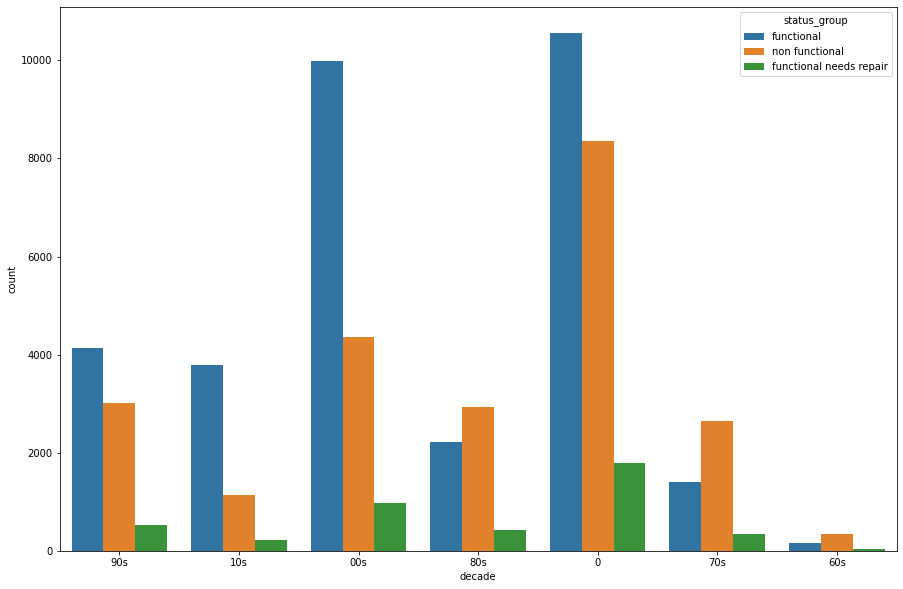

In [157]:
# Plot a graph
plt.figure(figsize=(15,10))
ax = sns.countplot(x='decade', hue="status_group", data=df)
# plt.savefig('./images/fig9.png')

It is evident that missing values and most recent years have more functional water points.


### recorded_by column

In [158]:
#View frequency of items on recorded_by column
df['recorded_by'].value_counts()

GeoData Consultants Ltd    59400
Name: recorded_by, dtype: int64

In [159]:
'''The recorded_by column has one value. 
This will not give any information to our model. 
So, dropped it too.
'''
# Dropping the column
df.drop(columns=['recorded_by'], inplace=True ) 

### installer column

There are lots of NaN and 0 values in this column. Firstly, we will convert them to unknown.

In [160]:
#View frequency of items on installer column
df['installer'].value_counts()

DWE                17402
Government          1825
RWE                 1206
Commu               1060
DANIDA              1050
                   ...  
Wizara  ya maji        1
TWESS                  1
Nasan workers          1
R                      1
SELEPTA                1
Name: installer, Length: 2145, dtype: int64

In [161]:
# Filling null values with unknown
df['installer'].fillna(value='Unknown',inplace=True)  

In [162]:
# To check the first common 100 values sum
df['installer'].value_counts().head(100).sum() 

47237

In [163]:
# Filling 0 values with unknown
df['installer'].replace(to_replace = '0', value ='Unknown' , inplace=True) 

In [164]:
# From the most common 100 value counts we realized some spelling mistakes or different syntax between same categories

# Replacing the spelling mistakes and collect same categories in same name

df['installer'].replace(to_replace = ('District Water Department', 'District water depar','Distric Water Department'),
                        value ='District water department' , inplace=True)

df['installer'].replace(to_replace = ('FinW','Fini water','FINI WATER'), value ='Fini Water' , inplace=True)
df['installer'].replace(to_replace = 'JAICA', value ='Jaica' , inplace=True)

df['installer'].replace(to_replace = ('COUN', 'District COUNCIL', 'DISTRICT COUNCIL','District Counci', 
                                      'District Council','Council','Counc','District  Council','Distri'),
                                    value ='District council' , inplace=True)

df['installer'].replace(to_replace = ('RC CHURCH', 'RC Churc', 'RC','RC Ch','RC C', 'RC CH','RC church', 
                                      'RC CATHORIC',) , value ='RC Church' , inplace=True)

df['installer'].replace(to_replace = ('Central Government','Tanzania Government',
                                       'central government','Cental Government', 'Cebtral Government', 
                                      'Tanzanian Government','Tanzania government', 'Centra Government' ,
                                      'CENTRAL GOVERNMENT', 'TANZANIAN GOVERNMENT','Central govt', 'Centr', 
                                      'Centra govt') , value ='Central government' , inplace=True)

df['installer'].replace(to_replace = ('World vision', 'World Division','World Vision'),
                                        value ='world vision' , inplace=True)

df['installer'].replace(to_replace = ('Unisef','UNICEF'),value ='Unicef' , inplace=True)
df['installer'].replace(to_replace = 'DANID', value ='DANIDA' , inplace=True)

df['installer'].replace(to_replace = ('villigers', 'villager', 'Villagers', 'Villa', 'Village', 'Villi', 
                                      'Village Council','Village Counil', 'Villages', 'Vill', 'Village community', 
                                      'Villaers', 'Village Community', 'Villag','Villege Council', 'Village council',
                                      'Village  Council','Villagerd', 'Villager', 'Village Technician',
                                      'Village Office','Village community members'),
                                        value ='villagers' , inplace=True)

df['installer'].replace(to_replace =('Commu','Communit','commu','COMMU', 'COMMUNITY') ,
                                        value ='Community' , inplace=True)

df['installer'].replace(to_replace = ('GOVERNMENT', 'GOVER', 'GOVERNME', 'GOVERM','GOVERN','Gover','Gove',
                                      'Governme','Governmen' ) ,value ='Government' , inplace=True)

df['installer'].replace(to_replace = 'Hesawa' ,value ='HESAWA' , inplace=True)

df['installer'].replace(to_replace = ('Colonial Government') , value ='Colonial government' , inplace=True)

df['installer'].replace(to_replace = ('Government of Misri') , value ='Misri Government' , inplace=True)

df['installer'].replace(to_replace = ('Italy government') , value ='Italian government' , inplace=True)

df['installer'].replace(to_replace = ('British colonial government') , value ='British government' , 
                                        inplace=True)
df['installer'].replace(to_replace = ('Concern /government') , value ='Concern/Government' , inplace=True)
df['installer'].replace(to_replace = ('Village Government') , value ='Village government' , inplace=True)
df['installer'].replace(to_replace = ('Government and Community') , value ='Government /Community' , 
                                        inplace=True)
df['installer'].replace(to_replace = ('Cetral government /RC') , value ='RC church/Central Gover' , 
                                        inplace=True)
df['installer'].replace(to_replace = ('Government /TCRS','Government/TCRS') , value ='TCRS /Government' , 
                                        inplace=True)
df['installer'].replace(to_replace = ('ADRA /Government') , value ='ADRA/Government' , inplace=True)

In [165]:
# Percentage of seen value counts of installer
(47237*100)/59400 

79.52356902356902

I checked the first 100 value counts of installer column mainly because I realized some installer names are incorrectly recorded such as: 'District Council' and 'District council'. So, I will change the values which were spotted. The first 100 value counts contains 47237 values. It means 79.5% of data is checked.


Now checking to see most common 20 values and visualize them to see the functionality. For this plot, I will not take the values which are smaller than 400. Reason being, this amount does not have majority in this data and it is not good to see thousands of values in same graph.

In [166]:
# Taking most 20 common installer
df['installer'].value_counts().head(20) 

DWE                   17402
Unknown                4435
Government             2660
Community              1674
DANIDA                 1602
HESAWA                 1379
RWE                    1206
District council       1179
Central government     1114
KKKT                    898
TCRS                    707
world vision            681
CES                     610
Fini Water              593
RC Church               461
villagers               408
LGA                     408
WEDECO                  397
TASAF                   396
Unicef                  332
Name: installer, dtype: int64

In [167]:
# Creating new dataframe which just picks our desired values

df_1 = df.loc[df['installer']== 'DWE']
df_2 = df.loc[df['installer']== 'Unknown']              
df_3 = df.loc[df['installer']== 'Government'] 
df_4 = df.loc[df['installer']== 'Community'] 
df_5 = df.loc[df['installer']== 'DANIDA'] 
df_6 = df.loc[df['installer']== 'RWE'] 
df_7 = df.loc[df['installer']== 'District council'] 
df_8 = df.loc[df['installer']== 'Central government']
df_9 = df.loc[df['installer']== 'KKKT'] 
df_10 = df.loc[df['installer']== 'HESAWA'] 
df_11 = df.loc[df['installer']== 'TCRS'] 
df_12 = df.loc[df['installer']== 'world vision'] 
df_13 = df.loc[df['installer']== 'CES'] 
df_14 = df.loc[df['installer']== 'Fini Water'] 
df_15 = df.loc[df['installer']== 'RC Church'] 
df_16 = df.loc[df['installer']== 'villagers']
df_17 = df.loc[df['installer']== 'LGA']

df_installer = pd.concat([df_1,df_2,df_3,df_4,df_5,df_6,df_7,df_8,df_9,df_10,df_11,df_12,
                          df_13,df_14,df_15,df_16,df_17], ignore_index=True)

#### Visualise the distribution of the status of a water feature across installer

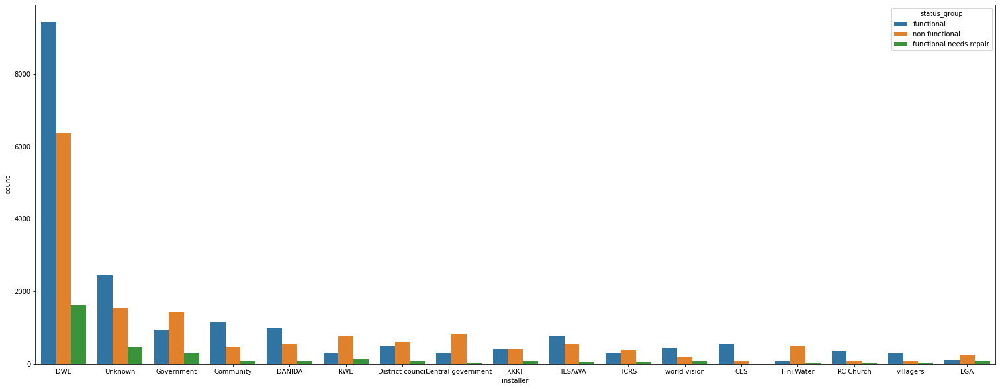

In [168]:
# Plot a graph
plt.figure(figsize=(26,10))
ax = sns.countplot(x='installer', hue="status_group", data=df_installer)
# plt.savefig('./images/fig10.png')

It is interesting that most of water points which central government and district council installed are non-functional. DWE has the majority of functional wells but has also many non-functional wells.

To ease the encoding later on, I will collect installers which has less than 400 value counts together and name them others.

In [169]:
# To make new categorizes, creating new column
df['installer_cat'] = df['installer'] 

In [170]:


# converting the values which has less than 400 value counts to others
c_ins = ['DWE','Unknown','Government','Community','DANIDA','RWE','District council', 'Central government',
         'KKKT','HESAWA','TCRS', 'world vision', 'Fini Water', 'RC Church','villagers','LGA']


df.loc[~df["installer_cat"].isin(c_ins), "installer_cat"] = "Others"

### funder column

In [171]:
# filling 0 and null values with unknown
df['funder'].fillna(value='Unknown',inplace=True)
df['funder'].replace(to_replace = '0', value ='Unknown' , inplace=True)

In [172]:
#View frequency of items on funder column
df['funder'].value_counts().head(20)

Government Of Tanzania    9084
Unknown                   4416
Danida                    3114
Hesawa                    2202
Rwssp                     1374
World Bank                1349
Kkkt                      1287
World Vision              1246
Unicef                    1057
Tasaf                      877
District Council           843
Dhv                        829
Private Individual         826
Dwsp                       811
Norad                      765
Germany Republi            610
Tcrs                       602
Ministry Of Water          590
Water                      583
Dwe                        484
Name: funder, dtype: int64

This column is highly categorical column with thousands different values. So, we will take most common 20 values for future encoding.

In [173]:
df1 = df.loc[df['funder']== 'Government Of Tanzania']
df2 = df.loc[df['funder']== 'Unknown']              
df3 = df.loc[df['funder']== 'Danida'] 
df4 = df.loc[df['funder']== 'Hesawa'] 
df5 = df.loc[df['funder']== 'Rwssp'] 
df6 = df.loc[df['funder']== 'World Bank'] 
df7 = df.loc[df['funder']== 'Kkkt'] 
df8 = df.loc[df['funder']== 'World Vision']
df9 = df.loc[df['funder']== 'Unicef'] 
df10 = df.loc[df['funder']== 'Tasaf'] 
df11 = df.loc[df['funder']== 'District Council'] 
df12 = df.loc[df['funder']== 'Dhv'] 
df13 = df.loc[df['funder']== 'Private Individual'] 
df14 = df.loc[df['funder']== 'Dwsp'] 
df15 = df.loc[df['funder']== 'Norad'] 
df16 = df.loc[df['funder']== 'Germany Republi']
df17 = df.loc[df['funder']== 'Tcrs']
df18 = df.loc[df['funder']== 'Ministry Of Water']
df19 = df.loc[df['funder']== 'Water']
df20 = df.loc[df['funder']== 'Dwe']

df_funder = pd.concat([df1,df2,df3,df4,df5,df6,df7,df8,df9,df10,df11,df12,
                          df13,df14,df15,df16,df17,df18,df19,df20], ignore_index=True)

#### Visualise the distribution of the status of a water feature across funder



[Text(0, 0, 'Government Of Tanzania'),
 Text(0, 0, 'Unknown'),
 Text(0, 0, 'Danida'),
 Text(0, 0, 'Hesawa'),
 Text(0, 0, 'Rwssp'),
 Text(0, 0, 'World Bank'),
 Text(0, 0, 'Kkkt'),
 Text(0, 0, 'World Vision'),
 Text(0, 0, 'Unicef'),
 Text(0, 0, 'Tasaf'),
 Text(0, 0, 'District Council'),
 Text(0, 0, 'Dhv'),
 Text(0, 0, 'Private Individual'),
 Text(0, 0, 'Dwsp'),
 Text(0, 0, 'Norad'),
 Text(0, 0, 'Germany Republi'),
 Text(0, 0, 'Tcrs'),
 Text(0, 0, 'Ministry Of Water'),
 Text(0, 0, 'Water'),
 Text(0, 0, 'Dwe')]

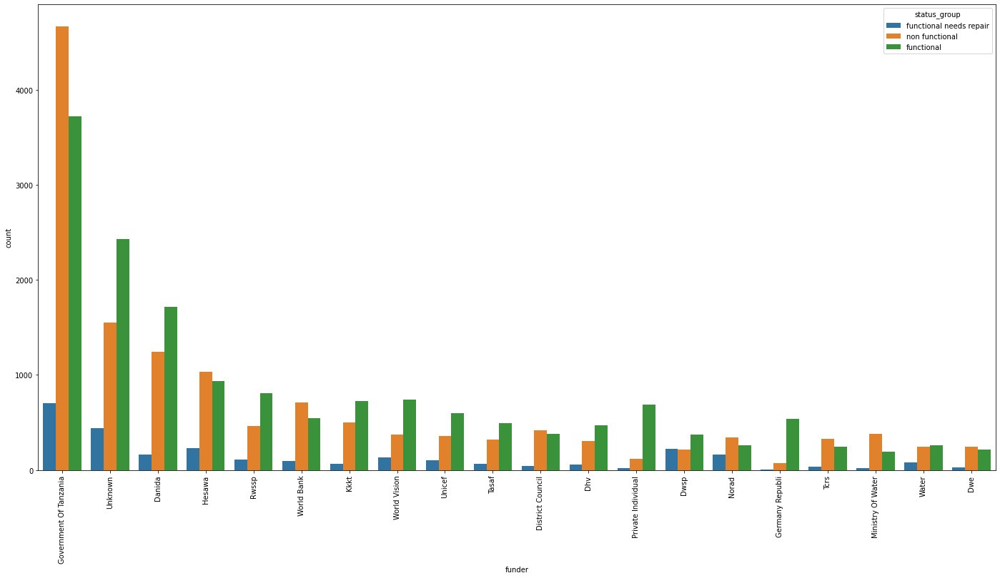

In [174]:
# Plot a graph
plt.figure(figsize=(24,12))
ax = sns.countplot(x='funder', hue="status_group", data=df_funder)
ax.set_xticklabels(ax.get_xticklabels(),rotation=90)
# plt.savefig('./images/fig11.png')

From the above plot, we realize that most of the water points which funded by government are non-functional.

In [175]:
# To collect values together
# Creating new column
df['funder_cat'] = df['funder'] 

c_fund = ['Danida','Unknown','Government Of Tanzania','Hesawa','Rwssp','World Bank','Kkkt', 'World Vision',
         'Unicef','Tasaf','District Council', 'Dhv', 'Private Individual', 'Dwsp','Norad','Germany Republi',
         'Tcrs','Ministry Of Water','Water','Dwe']
    

df.loc[~df["funder_cat"].isin(c_fund), "funder_cat"] = "Others"

### longitude column

In [176]:
from IPython.display import Image
# Image(filename='images/map.png')

The image above was taken from https://lib.ugent.be/fulltxt/RUG01/002/350/680/RUG01-002350680_2017_0001_AC.pdf to see the Tanzanian location and check the column values. Right side latitude must be -10.37.

You can access the pdf from the repository too: 

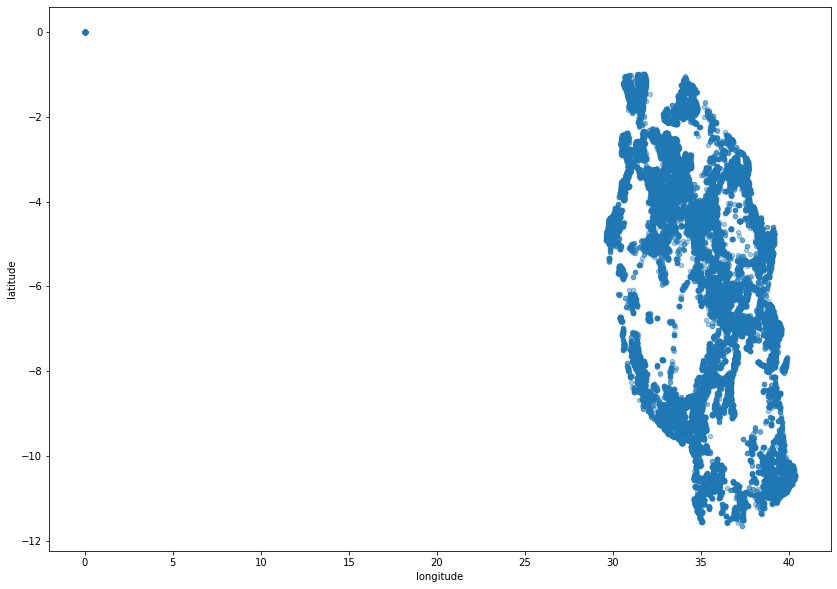

In [177]:
# Plot a graph to see the outliers
df.plot(kind='scatter', x="longitude", y="latitude", alpha=0.4, figsize=(14,10),sharex=False);
# plt.savefig('./images/fig12.png')

In [178]:
# To check outside of Tanzania
df.loc[df['longitude']==0] 

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,...,management,payment,water_quality,quantity,source,waterpoint_type,status_group,decade,installer_cat,funder_cat
21,6091,0.0,2013-02-10,Dwsp,0,DWE,0.0,-2.000000e-08,Muungano,0,...,wug,unknown,unknown,unknown,shallow well,hand pump,functional,0,DWE,Dwsp
53,32376,0.0,2011-08-01,Government Of Tanzania,0,Government,0.0,-2.000000e-08,Polisi,0,...,vwc,unknown,unknown,dry,machine dbh,communal standpipe multiple,non functional,0,Government,Government Of Tanzania
168,72678,0.0,2013-01-30,Wvt,0,WVT,0.0,-2.000000e-08,Wvt Tanzania,0,...,parastatal,other,soft,seasonal,rainwater harvesting,communal standpipe,functional,0,Others,Others
177,56725,0.0,2013-01-17,Netherlands,0,DWE,0.0,-2.000000e-08,Kikundi Cha Wakina Mama,0,...,wug,unknown,soft,enough,shallow well,other,non functional,0,DWE,Others
253,13042,0.0,2012-10-29,Hesawa,0,DWE,0.0,-2.000000e-08,Kwakisusi,0,...,vwc,never pay,soft,insufficient,shallow well,hand pump,functional needs repair,0,DWE,Hesawa
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59189,62177,0.0,2011-07-18,Dwsp,0,DWE,0.0,-2.000000e-08,Wazazo,0,...,wug,other,soft,enough,shallow well,hand pump,functional needs repair,0,DWE,Dwsp
59208,3631,0.0,2013-01-22,Dwsp,0,DWE,0.0,-2.000000e-08,Mtakuja,0,...,wug,unknown,soft,enough,shallow well,hand pump,functional,0,DWE,Dwsp
59295,60843,0.0,2011-07-19,Rwssp,0,DWE,0.0,-2.000000e-08,Maendeleo,0,...,wug,never pay,soft,enough,shallow well,hand pump,functional needs repair,0,DWE,Rwssp
59324,748,0.0,2013-01-22,World Vision,0,world vision,0.0,-2.000000e-08,Mwazwilo,0,...,wug,unknown,soft,enough,shallow well,hand pump,functional,0,world vision,World Vision


In [179]:
# To find the non-zero values mean
df.loc[df['longitude']!=0].describe()

,id,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,57588.00000,57588.000000,57588.000000,57588.000000,57588.000000,57588.000000,57588.000000,57588.000000,57588.000000,57588.000000
mean,37106.48807,327.645219,689.325137,35.149669,-5.885572,0.489060,15.217615,5.728311,185.570831,1997.859919
std,21454.51421,3043.831403,693.564188,2.607428,2.809876,12.426954,17.855254,9.760254,477.744239,10.331744
min,0.00000,0.000000,-90.000000,29.607122,-11.649440,0.000000,1.000000,0.000000,0.000000,1960.000000
25%,18522.75000,0.000000,0.000000,33.285100,-8.643841,0.000000,5.000000,2.000000,0.000000,1995.000000
50%,37054.50000,0.000000,426.000000,35.005943,-5.172704,0.000000,12.000000,3.000000,35.000000,2000.000000
75%,55667.25000,30.000000,1332.000000,37.233712,-3.372824,0.000000,17.000000,5.000000,230.000000,2004.000000
max,74247.00000,350000.000000,2770.000000,40.345193,-0.998464,1776.000000,99.000000,80.000000,30500.000000,2013.000000


It is obviously seen that it is written as 0 when the longtitude is unknown. Because, the zero points can seen easily in the graph above outliers and outside of Tanzania. So, I changed them to mean where median is the almost same value.

In [180]:
# Changing 0 values to mean
df['longitude'].replace(to_replace = 0 , value =35.15, inplace=True) 

### wpt_name / scheme_name / id/ region/ region_code columns


In [181]:
#View frequency of items on wpt_name column
df['wpt_name'].value_counts()

none                       3563
Shuleni                    1748
Zahanati                    830
Msikitini                   535
Kanisani                    323
                           ... 
Kwa Medadi                    1
Kwa Kubembeni                 1
Shule Ya Msingi Milanzi       1
Funua                         1
Kwa Mzee Lugawa               1
Name: wpt_name, Length: 37400, dtype: int64

In [182]:
#View frequency of items on scheme_name column
df['scheme_name'].value_counts()

K                       682
None                    644
Borehole                546
Chalinze wate           405
M                       400
                       ... 
Mradi wa maji Vijini      1
Villagers                 1
Magundi water supply      1
Saadani Chumv             1
Mtawanya                  1
Name: scheme_name, Length: 2696, dtype: int64

In [183]:
# To check the dublicates of id
df.duplicated(subset='id', keep='first').sum() 

0

In [184]:
df.drop(columns=['wpt_name','scheme_name','id','region_code'],inplace=True )

The wpt_name, scheme_name and id columns, they do not have any information about functionality. So, I decide to drop them. I also dropped region_code column because region column gives more information about the region. Also, before dropping columns we check the dulicated values in dataframe.

In [185]:
#View frequency of items on region column
df['region'].value_counts()

Iringa           5294
Shinyanga        4982
Mbeya            4639
Kilimanjaro      4379
Morogoro         4006
Arusha           3350
Kagera           3316
Mwanza           3102
Kigoma           2816
Ruvuma           2640
Pwani            2635
Tanga            2547
Dodoma           2201
Singida          2093
Mara             1969
Tabora           1959
Rukwa            1808
Mtwara           1730
Manyara          1583
Lindi            1546
Dar es Salaam     805
Name: region, dtype: int64

#### Visualise the distribution of the status of a water feature across region

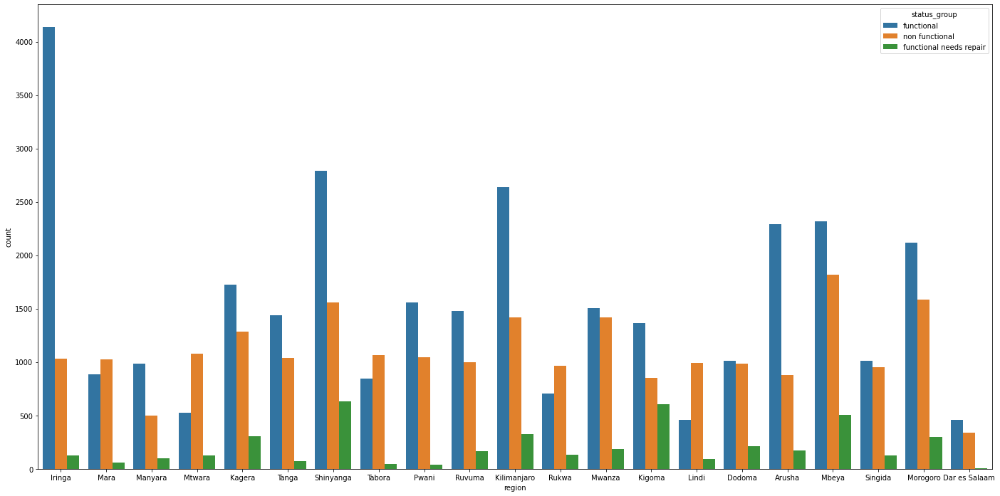

In [186]:
# Plot a graph
plt.figure(figsize=(24,12))
ax = sns.countplot(x='region', hue="status_group", data=df)
# plt.savefig('./images/fig13.png')

Some regions has higher probability of functional water well. Klimanjaro and Arusha have Pangani basin which has higher water point between basins. It is also seen that they have higher portions for functional wells.

### Explore Iringa and Dar es Salaam

In [187]:
# To see the Iringa area
df_iringa =df.loc[df['region']=='Iringa'] 

df_iringa.groupby(['water_quality','status_group']).count()

amount_tsh  date_recorded  funder  \
water_quality status_group                                                 
coloured      functional                        1              1       1   
              non functional                    1              1       1   
salty         functional                       19             19      19   
              non functional                    8              8       8   
soft          functional                     4120           4120    4120   
              functional needs repair         123            123     123   
              non functional                  983            983     983   
unknown       functional                        1              1       1   
              non functional                   38             38      38   

                                       gps_height  installer  longitude  \
water_quality status_group                                                
coloured      functional                        1          1          1   
              non functional                    1          1          1   
salty         functional                       19         19         19   
              non functional                    8          8          8   
soft          functional                     4120       4120       4120   
              functional needs repair         123        123        123   
              non functional                  983        983        983   
unknown       functional                        1          1          1   
              non functional                   38         38         38   

                                       latitude  num_private  basin  \
water_quality status_group                                            
coloured      functional                      1            1      1   
              non functional                  1            1      1   
salty         functional                     19           19     19   
              non functional                  8            8      8   
soft          functional                   4120         4120   4120   
              functional needs repair       123          123    123   
              non functional                983          983    983   
unknown       functional                      1            1      1   
              non functional                 38           38     38   

                                       subvillage  ...  construction_year  \
water_quality status_group                         ...                      
coloured      functional                        1  ...                  1   
              non functional                    1  ...                  1   
salty         functional                       19  ...                 19   
              non functional                    8  ...                  8   
soft          functional                     4120  ...               4120   
              functional needs repair         123  ...                123   
              non functional                  983  ...                983   
unknown       functional                        1  ...                  1   
              non functional                   38  ...                 38   

                                       extraction_type_group  management  \
water_quality status_group                                                 
coloured      functional                                   1           1   
              non functional                               1           1   
salty         functional                                  19          19   
              non functional                               8           8   
soft          functional                                4120        4120   
              functional needs repair                    123         123   
              non functional                             983         983   
unknown       functional                                   1  

Iringa area the has highest water points. There are also 983 wells which has soft, good water but non-functional.


In [188]:
#To see the Dar es Salaam area
df_daressalaam =df.loc[df['region']=='Dar es Salaam'] 

In [189]:
df_daressalaam.groupby(['water_quality','status_group']).count()

amount_tsh  date_recorded  funder  \
water_quality      status_group                                                 
fluoride abandoned non functional                    2              2       2   
milky              functional                        1              1       1   
                   non functional                    1              1       1   
salty              functional                       41             41      41   
                   non functional                  100            100     100   
salty abandoned    functional                       63             63      63   
                   non functional                   37             37      37   
soft               functional                      352            352     352   
                   functional needs repair           3              3       3   
                   non functional                  186            186     186   
unknown            functional                        4              4       4   
                   non functional                   15             15      15   

                                            gps_height  installer  longitude  \
water_quality      status_group                                                
fluoride abandoned non functional                    2          2          2   
milky              functional                        1          1          1   
                   non functional                    1          1          1   
salty              functional                       41         41         41   
                   non functional                  100        100        100   
salty abandoned    functional                       63         63         63   
                   non functional                   37         37         37   
soft               functional                      352        352        352   
                   functional needs repair           3          3          3   
                   non functional                  186        186        186   
unknown            functional                        4          4          4   
                   non functional                   15         15         15   

                                            latitude  num_private  basin  \
water_quality      status_group                                            
fluoride abandoned non functional                  2            2      2   
milky              functional                      1            1      1   
                   non functional                  1            1      1   
salty              functional                     41           41     41   
                   non functional                100          100    100   
salty abandoned    functional                     63           63     63   
                   non functional                 37           37     37   
soft               functional                    352          352    352   
                   functional needs repair         3            3      3   
                   non functional                186          186    186   
unknown            functional                      4            4      4   
                   non functional                 15           15     15   

                                            subvillage  ...  \
water_quality      status_group                         ...   
fluoride abandoned non functional                    2  ...   
milky              functional                        1  ...   
                   non functional                    1  ...   
salty              functional                       41  ...   
                   non functional                  100  ...   
salty abandoned    functional                       63  ...   
                   non functional                   37  ...   
soft               functional                      352  ...   
                   functional needs repair           3  ...   
                   non functio

It is unfortunate that Dar es Salaam is most populated area in Tanzania with its rural areas around, but water points are not enough. Even, 35% of the soft water wells are non-functional.

### Amount_tsh column

In [190]:
#View frequency of items on amount_tsh column
df['amount_tsh'].value_counts()

0.0         41639
500.0        3102
50.0         2472
1000.0       1488
20.0         1463
            ...  
6300.0          1
120000.0        1
138000.0        1
350000.0        1
59.0            1
Name: amount_tsh, Length: 98, dtype: int64

In [191]:
df.loc[df['amount_tsh']==0].groupby('status_group').count()

,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,num_private,basin,subvillage,...,extraction_type_group,management,payment,water_quality,quantity,source,waterpoint_type,decade,installer_cat,funder_cat
status_group,,,,,,,,,,,,,,,,,,,,,
functional,19706,19706,19706,19706,19706,19706,19706,19706,19706,19501,...,19706,19706,19706,19706,19706,19706,19706,19706,19706,19706
functional needs repair,3048,3048,3048,3048,3048,3048,3048,3048,3048,3047,...,3048,3048,3048,3048,3048,3048,3048,3048,3048,3048
non functional,18885,18885,18885,18885,18885,18885,18885,18885,18885,18720,...,18885,18885,18885,18885,18885,18885,18885,18885,18885,18885


In [192]:
df['amount_tsh'].value_counts()/df['amount_tsh'].count()

0.0         0.700993
500.0       0.052222
50.0        0.041616
1000.0      0.025051
20.0        0.024630
              ...   
6300.0      0.000017
120000.0    0.000017
138000.0    0.000017
350000.0    0.000017
59.0        0.000017
Name: amount_tsh, Length: 98, dtype: float64

70% of the column has no informative values. So, this column will not give idea to our model and we will drop it.

In [193]:
df.drop(columns=['amount_tsh'],inplace=True )

### gps_height column

In [194]:
#View frequency of items on gps_height column
df['gps_height'].value_counts()

 0       20438
-15         60
-16         55
-13         55
 1290       52
         ...  
 2378        1
-54          1
 2057        1
 2332        1
 2366        1
Name: gps_height, Length: 2428, dtype: int64

In [195]:
df['gps_height'].value_counts()/df['gps_height'].count()

 0       0.344074
-15      0.001010
-16      0.000926
-13      0.000926
 1290    0.000875
           ...   
 2378    0.000017
-54      0.000017
 2057    0.000017
 2332    0.000017
 2366    0.000017
Name: gps_height, Length: 2428, dtype: float64

In [196]:
df.groupby('status_group')[['gps_height']].mean()

,gps_height
status_group,
functional,740.131188
functional needs repair,627.607135
non functional,574.464774


Gps height shows the level of the water point from sea level. There are 34% zero values but maybe 34% of the water points are at the sea level so no change for this column at the moment.


### population column


In [197]:
#View frequency of items on population column
df['population'].value_counts()

0       21381
1        7025
200      1940
150      1892
250      1681
        ...  
6330        1
5030        1
656         1
948         1
788         1
Name: population, Length: 1049, dtype: int64

In [198]:
df.loc[df['population']==0].groupby('status_group').count()

,date_recorded,funder,gps_height,installer,longitude,latitude,num_private,basin,subvillage,region,...,extraction_type_group,management,payment,water_quality,quantity,source,waterpoint_type,decade,installer_cat,funder_cat
status_group,,,,,,,,,,,,,,,,,,,,,
functional,11274,11274,11274,11274,11274,11274,11274,11274,11071,11274,...,11274,11274,11274,11274,11274,11274,11274,11274,11274,11274
functional needs repair,1775,1775,1775,1775,1775,1775,1775,1775,1775,1775,...,1775,1775,1775,1775,1775,1775,1775,1775,1775,1775
non functional,8332,8332,8332,8332,8332,8332,8332,8332,8174,8332,...,8332,8332,8332,8332,8332,8332,8332,8332,8332,8332


Some functional water points has zero population, therefore a good move to change zero population to mean.



In [199]:
# To see without zero mean and median
df.loc[df['population']!=0].describe() 

,gps_height,longitude,latitude,num_private,district_code,population,construction_year
count,38019.000000,38019.000000,38019.000000,38019.000000,38019.000000,38019.000000,38019.000000
mean,969.889634,36.074387,-6.139781,0.740788,6.299456,281.087167,1996.908283
std,612.544787,2.586779,2.737733,15.288297,11.303334,564.687660,12.425377
min,-90.000000,29.607122,-11.649440,0.000000,1.000000,1.000000,1960.000000
25%,347.000000,34.715340,-8.388839,0.000000,2.000000,40.000000,1988.000000
50%,1135.000000,36.706815,-5.750877,0.000000,3.000000,150.000000,2000.000000
75%,1465.000000,37.940149,-3.597016,0.000000,5.000000,324.000000,2008.000000
max,2770.000000,40.345193,-1.042375,1776.000000,67.000000,30500.000000,2013.000000


In [200]:
# Changing 0's to mean
df['population'].replace(to_replace = 0 , value =281, inplace=True) 

In [201]:
df.sort_values(by='population', ascending=False).head(50).groupby('status_group').count()

,date_recorded,funder,gps_height,installer,longitude,latitude,num_private,basin,subvillage,region,...,extraction_type_group,management,payment,water_quality,quantity,source,waterpoint_type,decade,installer_cat,funder_cat
status_group,,,,,,,,,,,,,,,,,,,,,
functional,39,39,39,39,39,39,39,39,39,39,...,39,39,39,39,39,39,39,39,39,39
functional needs repair,4,4,4,4,4,4,4,4,4,4,...,4,4,4,4,4,4,4,4,4,4
non functional,7,7,7,7,7,7,7,7,7,7,...,7,7,7,7,7,7,7,7,7,7


To see the most populated areas water point functionality , I opted for crowded 50 values and did groupby. It shows that higher population areas have more functional water points.


### date_recorded column

Approximately 95% of the water points were recorded between 2011-2013. So, for now we do not think it contains necessary information about functionality. We drop this column for now.

In [202]:
df.drop(columns=['date_recorded'],inplace=True )

### num_private column


This column has no information about it and also mostly have zero values. So, drop this too.

In [203]:
df.drop(columns=['num_private'],inplace=True )

### basin column

In [204]:
#View frequency of items on basin column
df['basin'].value_counts()

Lake Victoria              10248
Pangani                     8940
Rufiji                      7976
Internal                    7785
Lake Tanganyika             6432
Wami / Ruvu                 5987
Lake Nyasa                  5085
Ruvuma / Southern Coast     4493
Lake Rukwa                  2454
Name: basin, dtype: int64

#### Visualise the distribution of the status of a water feature across basin


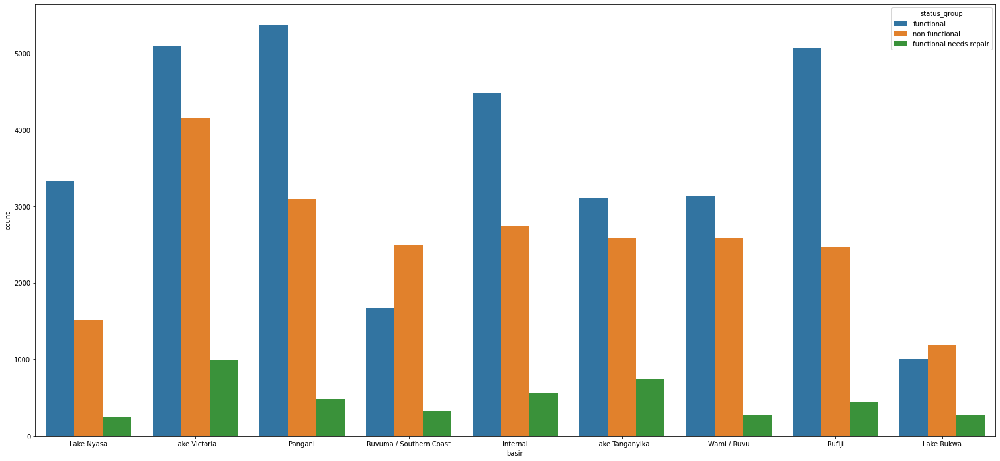

In [205]:
#Plot a graph
plt.figure(figsize=(26,12))
ax = sns.countplot(x='basin', hue="status_group", data=df)
# plt.savefig('./images/fig14.png')

This visualization gives an idea about there is correlation between functionality and geographical water basin.


### subvillage column

In [206]:
#View frequency of items on subvillage column
df['subvillage'].nunique()

19287

This column has location value of water point regions but we already have region column. I will drop this, because it is hard to handle this nunique object values.

In [207]:
df.drop(columns=['subvillage'],inplace=True )

### district_code column


In [208]:
#View frequency of items on district_code column
df['district_code'].value_counts()

1     12203
2     11173
3      9998
4      8999
5      4356
6      4074
7      3343
8      1043
30      995
33      874
53      745
43      505
13      391
23      293
63      195
62      109
60       63
0        23
80       12
67        6
Name: district_code, dtype: int64

It includes numeric values about districts. Each district has one number.


#### Visualise the distribution of the status of a water feature across basin


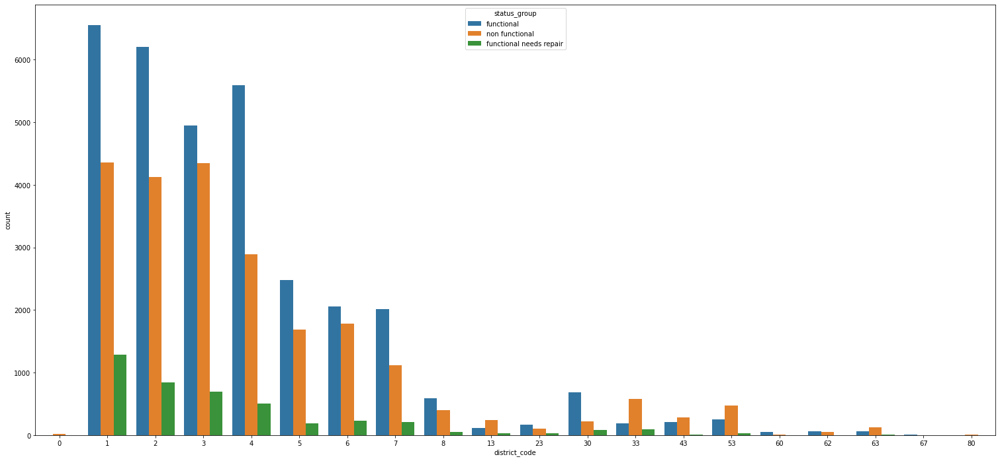

In [209]:
# Plot a graph
plt.figure(figsize=(26,12))
ax = sns.countplot(x='district_code', hue="status_group", data=df)
# plt.savefig('./images/fig15.png')

Some districts has higher chance to have functional water points.


### lga / ward columns


Keep these columns because they contain geographical location. But, we have also other location features so maybe they will be dropped later on.


### public_meeting column

In [210]:
#View frequency of items on public_meeting column
df['public_meeting'].value_counts()

True     51011
False     5055
Name: public_meeting, dtype: int64

In [211]:
#There are some null values and we convert them to most common data.
df['public_meeting'].fillna(value=True,inplace=True)

### permit column


In [212]:
#View frequency of items on permit column
df['permit'].value_counts()

True     38852
False    17492
Name: permit, dtype: int64

This column shows if the water point is permitted or not. There are 3056 null values for this column. Changed them to true which has higher amount.



In [213]:
df['permit'].fillna(value=True, inplace=True)

# Convert Target Values to Ternary Values

To make our model, I opted to change the target variable to 0,1 and 2 values.

In [214]:
status = {'functional':0, 
                   'non functional': 2, 
                   'functional needs repair': 1} 
df['status_group'] = df['status_group'].replace(status)

In [215]:
df['status_group'].value_counts()

0    32259
2    22824
1     4317
Name: status_group, dtype: int64

In [216]:
# Creating new csv file to keep the new cleaned data
# df.to_csv('eda_data.csv')


# A Summary of the EDA Process



## Exploration Observations

- Generally higher population areas has higher number of functional wells.
- Some areas have higher probability to find clean water especially, if they are near good basins.
- Dar es Salaam is one of the highest populated cities but 35% of good water quality points are non-functional.
- Iringa is one of the important areas but it contains lots of non-functional wateer points which has soft water.
- Mostly the wells which are funded by government are non-functional.
- Most of water points which central government and district council installed are non-functional.
- The most common extraction type is gravity but second is hand pumps. The efficiency of handpumps is less than commercial pumps. This shows that authorities need to focus on pumping type. It is seen that, there are many non-functional water points which belongs to gravity as extraction type.
- Some water points that have enough and soft water are non-function.
- The wells that were constructed in recent years are more functional than older ones. It is evident that recent wells have better functionality but needs repair sooner or later. 
- There are lots of water wells which has enough water are non-functional. 




## Findings

- 4272 wells were dried but they have good water quality. With a sound solution, these wells can be functional. Finding clean water sources is not the only problem, to continue to feed these sources are equaly important.
- 2226 (7%) wells have enough and soft water but need repair. Authorities must invest on repairing. Otherwise these will be non-functional.
- 8035 (27%) wells has enough, good quality water but they are non-functional. This shows that authorities must work and invest on technology to pump these good sources.
- Authorties should check again the wells which they funded.
- New tecqniques must be found to feed dry wells and repair wells.



# Feature Engineering


- There are lots of categorical values in funder and installer columns. I create new columns that if the value in the feature is not in first common 20 values, they were collected as 'others'. Also, there are lots of spelling mistakes in these columns which creates new unique values in these columns. We found top 100 common installer and fixed them. Then, built a new column which has categorized values. 
- Construction years are in integer format and didn't  not make sense for model. So, I divided the decades and assumed every decade as categorical value.
- There will be more feature selection and engineering techniques applied ahead.

# Modeling

To find the best model, firstly we will try to simplify our problem. I will have to use different modeling techniques. I will use different encoder, scaler , classifier and try different models. To simply find the best model, first merge functional and functional but there is need repair target labels, and assign this to target. Then, we will assign non-functional to 0. First, we will try simple model then we will try to improve it. After finding the best model, we will try it for the multi-class label format.

After that, decided to scale and encode, we tried DecisionTree Classifier, ExtraTreesClassifier and Random Forest. We found good results for Random Forest so we decided to do grid search to find best parameters. After we set this, we did feature importance to select best features and drop less important features. This can help us for future, when we want to do feature engineering.

After looking for the feature importance, we tried XGBoost, K-Nearest and LGBM Classifiers. And, lastly I decided the best model for binary target as Random Forest with grid search. It produced the best scores.



In [217]:
# importing necessary libraries

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import KBinsDiscretizer, FunctionTransformer,RobustScaler
from sklearn.model_selection import cross_val_score
from category_encoders import OneHotEncoder
from sklearn.pipeline import make_pipeline, Pipeline

from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import roc_auc_score

from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split, GridSearchCV

import warnings
warnings.filterwarnings("ignore")

import category_encoders as ce
from category_encoders import WOEEncoder
from sklearn.metrics import accuracy_score, balanced_accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

from sklearn.compose import ColumnTransformer
from category_encoders import TargetEncoder, LeaveOneOutEncoder, JamesSteinEncoder, MEstimateEncoder

from mlxtend.evaluate import confusion_matrix
from mlxtend.plotting import plot_confusion_matrix
from mlxtend.plotting import plot_decision_regions
from sklearn.preprocessing import MinMaxScaler
from mlxtend.evaluate import feature_importance_permutation
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier

from sklearn.svm import SVC
import gc; gc.enable()

import xgboost as xgb
from xgboost import XGBClassifier

from sklearn.neighbors import KNeighborsClassifier
import lightgbm as lgb



In [218]:
# Getting the new dataframe
df = pd.read_csv('/content/eda_data.csv') 

# View all columns
pd.options.display.max_columns=100 

# Display first 5 rows
df.head()

,Unnamed: 0,funder,gps_height,installer,longitude,latitude,basin,region,district_code,lga,ward,population,public_meeting,permit,construction_year,extraction_type_group,management,payment,water_quality,quantity,source,waterpoint_type,status_group,decade,installer_cat,funder_cat
0,0,Roman,1390,Roman,34.938093,-9.856322,Lake Nyasa,Iringa,5,Ludewa,Mundindi,109,True,False,1999,gravity,vwc,pay annually,soft,enough,spring,communal standpipe,0,90s,Others,Others
1,1,Grumeti,1399,GRUMETI,34.698766,-2.147466,Lake Victoria,Mara,2,Serengeti,Natta,280,True,True,2010,gravity,wug,never pay,soft,insufficient,rainwater harvesting,communal standpipe,0,10s,Others,Others
2,2,Lottery Club,686,world vision,37.460664,-3.821329,Pangani,Manyara,4,Simanjiro,Ngorika,250,True,True,2009,gravity,vwc,pay per bucket,soft,enough,dam,communal standpipe multiple,0,00s,world vision,Others
3,3,Unicef,263,Unicef,38.486161,-11.155298,Ruvuma / Southern Coast,Mtwara,63,Nanyumbu,Nanyumbu,58,True,True,1986,submersible,vwc,never pay,soft,dry,machine dbh,communal standpipe multiple,2,80s,Others,Unicef
4,4,Action In A,0,Artisan,31.130847,-1.825359,Lake Victoria,Kagera,1,Karagwe,Nyakasimbi,281,True,True,2000,gravity,other,never pay,soft,seasonal,rainwater harvesting,communal standpipe,0,0,Others,Others


In [219]:
df.shape

(59400, 26)

In [220]:
# Dropped some columns for now, because we have categorized versions of them
df.drop(columns=['Unnamed: 0','funder','installer','construction_year'],inplace=True )

# To protect original df , take the copy of it
df1 = df.copy() 

In [221]:
# Drop these columns for now
df1.drop(columns=['lga','ward'],inplace=True ) 

# Changing from True/False to 0-1
df1['permit'] = df1['permit'].astype(bool).astype(int)

# Changing from True/False to 0-1
df1['public_meeting'] = df1['public_meeting'].astype(bool).astype(int) 

Using scaler for numeric columns and encoder for categorical columns. So, divide columns in two.



In [222]:
# Categorical columns
category_column = ['basin','region','extraction_type_group','management','payment','water_quality','quantity',
               'source','waterpoint_type','decade','installer_cat','funder_cat']

# Numerical columns
numerical_column = ['gps_height','longitude','latitude','district_code','population','public_meeting','permit']

In [223]:
df1['status_group'].value_counts()

0    32259
2    22824
1     4317
Name: status_group, dtype: int64

Remember:

0 = functional water points ,

1 = functional but needs repair water points,

2 = non-functinal water points

Collecting 'functional' and 'functional but needs repair' target together and make them 1, 'non-functional' is 0.

In [224]:
# Converting them 
target_status_group = {0:1, 1: 1, 2 : 0}
df1['status_group'] = df1['status_group'].replace(target_status_group)

In [225]:
df1['status_group'].value_counts()

1    36576
0    22824
Name: status_group, dtype: int64

In [226]:
# Assign status_group column as target
target='status_group' 

# Making Baseline

In [227]:
# Dividing X and target 

used_cols = [c for c in df1.columns.tolist() if c not in [target]]
X=df1[used_cols]
y=df1[target]

In [228]:
# To divide our X and y to test and train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

Now use train test split first to figure out the problem. After learning from the baseline, use cross validation technique to find the best result. Cross validation is more convenient and easy to understand how is going on. The metric for competition is balanced accuracy. But, to make sure and understand the progress, we want to check roc_auc score also especially for some models.

Creating an empty dataframe to write our results on it to keep when parameters changed.

In [229]:
 # To see all results
df_results = pd.DataFrame(columns=["Model", "Scaler",'Encoder',
                                   'roc_auc score mean', 'roc_auc score std'])

## Baseline - Robust Scaler/ Target Encoder with LogReg


To scale numeric values and encode categorical columns, I will make a pipeline and also use it in our model and classifier changes. 
For the first trial we use Robust Scaler as a scaler. Robust scales variables using statistics that are strong to outliers. Robust Scaler use IQR(Interquartile Range). 

As for the encoder, I will try Target Encoder which works well with higher cardinality features. Our data has higher unique values also. 
The first trial for baseline is Logistic Regression which predicts the probability that a certain instance belongs to a class. I chose balanced as class weight, because our classes have a class imbalance. Also, a solver is an algorithm to use in the optimization problem and for multiclass problems ‘lbfgs’ can handle multinomial loss.

In [230]:
# Making pipeline

scaler = RobustScaler()
encoder = ce.TargetEncoder(cols=category_column)

# Putting numeric columns to scaler and categorical to encoder
numeric_transformer = make_pipeline(scaler)
categorical_transformer = make_pipeline(encoder)

# getting together our scaler and encoder with preprocessor
preprocessor = ColumnTransformer(
      transformers=[('num', numeric_transformer, numerical_column),
                    ('cat', categorical_transformer, category_column)])


# Choosing model
lr = LogisticRegression(class_weight = 'balanced', solver = 'lbfgs', random_state=42)

# Giving all values to pipeline
pipe = make_pipeline(preprocessor,lr)
pipe.fit(X_train, y_train)


# Make predictions on training set
y_pred = pipe.predict(X_train)

# Make predictions on test set
y_pred_test = pipe.predict(X_test)

# Print the results 
print("Accuracy:"); print("="*len("Accuracy:"))
print(f"TRAIN: {accuracy_score(y_train, y_pred)}")
print(f"TEST: {accuracy_score(y_test, y_pred_test)}")

print("\nBalanced Accuracy:"); print("="*len("Balanced Accuracy:"))
print(f"TRAIN: {balanced_accuracy_score(y_train, y_pred)}")
print(f"TEST: {balanced_accuracy_score(y_test, y_pred_test)}")


Accuracy:
TRAIN: 0.7727048260381594
TEST: 0.7721212121212121

Balanced Accuracy:
TRAIN: 0.7516395314997
TEST: 0.7499106351059713


These values can be chosen as baseline. There already is fine acceptable results for the baseline. There is a slight overfit. For better understanding, plotted a confusion matrix.

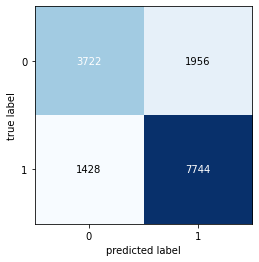

In [231]:
# Plot a confusion matrix
cm = confusion_matrix(y_test, y_pred_test)
plot_confusion_matrix(cm)
plt.show()

From the matrix, we can make some interpretations. Such that, 1129 represents water features predicted as non-functional but normally they are functional. And, 1553 predicted as functional, but normally they are non-functional.

Next is taking the roc_auc score with doing LogReg with cross validation to compare other model results. I will take the mean of the scores, and standard deviation to understand better. 

Went with  cv = 5, it gives 5 different results for each trial and use their mean. This application will give more accurate results. Instead of train-test splits, opted for cross validation which split train-test itself and do it for 5 times. It takes more time than train-test split so in some models, train-test split will be used again.



In [232]:
scores = cross_val_score(pipe, X, y, cv=5, scoring='roc_auc')
print(scores.mean(), "+/-", scores.std()) 

0.8313588694370215 +/- 0.004012026484651188


Better results than splitting. And this result is better enough for baseline. Std deviation is not too high also. These results also show us the data cleaning work done prevously was impressive. That is translated to our model perfomance.



In [233]:
# Storing the first trial results in the results dataframe 
df_results = df_results.append({        
     "Model": 'LogReg' ,
      "Scaler": 'Robust' , 
       'Encoder' : 'TargetEncoder',
               'roc_auc score mean' : 0.8313,
                    'roc_auc score std' : 0.0041}, ignore_index=True)


# Robust Scaler/ WoE Encoder with LogReg



The weight of evidence encoder works as the predictive power of an independent variable according to the dependent variable. A bad vs good scenario. Basically, it is calculating the % of events and % of non-events.

NOTE: WoE is better than on-hot encoding as this method of variable transformation does not increase the complexity of the model.

In [234]:
scaler = RobustScaler()
encoder = ce.WOEEncoder(cols=category_column)

# Putting numeric columns to scaler and categorical to encoder
numeric_transformer = make_pipeline(scaler)
categorical_transformer = make_pipeline(encoder)

# Getting our scaler and encoder together with preprocessor
preprocessor = ColumnTransformer(
      transformers=[('num', numeric_transformer, numerical_column),
                    ('cat', categorical_transformer, category_column)])

# Giving all values to pipeline
pipe = make_pipeline(preprocessor,lr)

scores = cross_val_score(pipe, X, y, cv=5, scoring='roc_auc')
print(scores.mean(), "+/-", scores.std())

0.8317616620004907 +/- 0.0040460161388364115


The result is better than baseline. So, changing our encoder to this one.

In [235]:
# Store this in the results dataframe
df_results = df_results.append({       
     "Model": 'LogReg' ,
      "Scaler": 'Robust' , 
       'Encoder' : 'WeO',
                'roc_auc score mean' : 0.8318,
                    'roc_auc score std' : 0.0040}, ignore_index=True)


# Robust Scaler/ OneHot Encoder with LogReg

In [236]:
scaler = RobustScaler()
encoder = ce.OneHotEncoder(cols=category_column)

# Putting numeric columns to scaler and categorical to encoder
numeric_transformer = make_pipeline(scaler)
categorical_transformer = make_pipeline(encoder)

# Getting our scaler and encoder together with preprocessor
preprocessor = ColumnTransformer(
      transformers=[('num', numeric_transformer, numerical_column),
                    ('cat', categorical_transformer, category_column)])

pipe = make_pipeline(preprocessor,lr)

scores = cross_val_score(pipe, X, y, cv=5, scoring='roc_auc')
print(scores.mean(), "+/-", scores.std())

pipe.fit(X_train, y_train)

# Make predictions on training set
y_pred = pipe.predict(X_train)

# Make predictions on test set
y_pred_test = pipe.predict(X_test)

# Print the results
print("Accuracy:"); print("="*len("Accuracy:"))
print(f"TRAIN: {accuracy_score(y_train, y_pred)}")
print(f"TEST: {accuracy_score(y_test, y_pred_test)}")

print("\nBalanced Accuracy:"); print("="*len("Balanced Accuracy:"))
print(f"TRAIN: {balanced_accuracy_score(y_train, y_pred)}")
print(f"TEST: {balanced_accuracy_score(y_test, y_pred_test)}")


0.8538527351519243 +/- 0.002421380247314917
Accuracy:
TRAIN: 0.7927497194163861
TEST: 0.7898989898989899

Balanced Accuracy:
TRAIN: 0.777833411962344
TEST: 0.7741981660956581


Although one-hot encoder gives the best value, we choose our encoder as weight of evidence encoder. Because one-hot encoder creates a binary feature for each unique value in column. So, it is not very useful for high cardinality categorical values like our data. Because, it takes too much time to run the model each time.

In [237]:
# Store this in the results dataframe
df_results = df_results.append({       
     "Model": 'LogReg' ,
      "Scaler": 'Robust' , 
       'Encoder' : 'OneHot',
                'roc_auc score mean' : 0.8538,
                    'roc_auc score std' : 0.0024}, ignore_index=True)


# MinMax Scaler/ WoE Encoder with LogReg


When the distribution is not Gaussian or the standard deviation is very small, the min-max scaler generally works well. So, let's see and compare our scalers.

In [238]:
scaler = MinMaxScaler()
encoder = ce.WOEEncoder(cols=category_column)

# Putting numeric columns to scaler and categorical to encoder
numeric_transformer = make_pipeline(scaler)
categorical_transformer = make_pipeline(encoder)

# Getting our scaler and encoder together with preprocessor
preprocessor = ColumnTransformer(
      transformers=[('num', numeric_transformer, numerical_column),
                    ('cat', categorical_transformer, category_column)])

# Giving all values to pipeline
pipe = make_pipeline(preprocessor,lr)

scores = cross_val_score(pipe, X, y, cv=5, scoring='roc_auc')
print(scores.mean(), "+/-", scores.std())

0.8317305177352541 +/- 0.0040036182921556335


The result does not change significantly so, settling with encoder as WoE and scaler as Robust.

In [239]:
# Store this in the results dataframe
df_results = df_results.append({    
     "Model": 'LogReg' ,
      "Scaler": 'MinMax' , 
       'Encoder' : 'WoE',
                'roc_auc score mean' : 0.8317,
                    'roc_auc score std' : 0.0040}, ignore_index=True)


# Comparing Different Encoder and Scalers

In [240]:
df_results

,Model,Scaler,Encoder,roc_auc score mean,roc_auc score std
0,LogReg,Robust,TargetEncoder,0.8313,0.0041
1,LogReg,Robust,WeO,0.8318,0.0040
2,LogReg,Robust,OneHot,0.8538,0.0024
3,LogReg,MinMax,WoE,0.8317,0.0040


For the updated baseline, opted for WOE encoder with Robust scaler. Although, one hot encoder gave better results, it is not very suitable for our dataset which contains high unique numbers in columns.



# Decision Tree Classifier

From logistic regression, we have 0.83 roc-auc score. To improve this, we will try new models. First trial is Decision Tree Classifier.

In [241]:
# Settled on the parameters  listed to get the best perfomance
dt = DecisionTreeClassifier(criterion='entropy', max_depth=4, min_samples_leaf=5, 
                            random_state=42, class_weight='balanced')

pipe = make_pipeline(preprocessor,dt)

scores = cross_val_score(pipe, X, y, cv=5, scoring='roc_auc')
print(scores.mean(), "+/-", scores.std())

0.7863597503694137 +/- 0.008899848335360306


In [242]:
# Store this in the results dataframe
df_results = df_results.append({   
     "Model": 'DecisionTreeClassifier' ,
      "Scaler": 'Robust' , 
       'Encoder' : 'WoE',
                'roc_auc score mean' : 0.7864,
                    'roc_auc score std' : 0.0089}, ignore_index=True)

# RandomForestClassifier

Random forest models can reduce overfitting risk by randomness as building n_estimators, bootstrapping sample and splitting nodes on the best split among a random subset of the features selected at every node and converting non-homogeneous node into best possibilities.

In [243]:
rf = RandomForestClassifier(n_estimators=50, random_state=42, n_jobs=-1,class_weight='balanced')

pipe = make_pipeline(preprocessor,rf)

scores = cross_val_score(pipe, X, y, cv=5, scoring='roc_auc')
print(scores.mean(), "+/-", scores.std())

0.9191312783904723 +/- 0.0029645415943909603


In [244]:
# Store this in the results dataframe
df_results = df_results.append({   
     "Model": 'RandomForestClassifier' ,
      "Scaler": 'Robust' , 
       'Encoder' : 'WoE',
                'roc_auc score mean' : 0.9193,
                    'roc_auc score std' : 0.0022}, ignore_index=True)

RandomForest classifier produced the best results so far. I played around parameters and found these as a first trial. Now, with grid search I can find better results with tuning our parameters.



# Finding Best Parameters with Grid Search

Grid search shows us the best parameters for model. To run grid search with encoder and scaler as preprocessing takes too much time. So, copied our dataframe and encoded categorical columns. Then, used this encoded dataframe.

In [245]:
 # Taking copy of dataframe
df2=df1.copy()

In [246]:
# Encoding categorical columns turning them to numerals
encoder = WOEEncoder()

for c in category_column:
    df2[str(c) + '_encoded'] = encoder.fit_transform(df2[c].values, df2[target])
    df2.drop(columns=c, inplace=True)

In [247]:
# Dividing our X and y and train-test splits

used_cols1 = [c for c in df2.columns.tolist() if c not in [target]]
X1=df2[used_cols1]
y1=df2[target]

X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.2, random_state=42)

In [248]:
# Setting grid search parameters and fit and run them
grid_p = {"n_estimators": [20, 50, 100],
          "criterion": ["gini", "entropy"],
          "max_features": ['sqrt', 'log2'],
          "min_samples_split": [2, 5, 10]}

grid_search = GridSearchCV(rf, grid_p, n_jobs=-1, cv=5, scoring='roc_auc')
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=RandomForestClassifier(class_weight='balanced',
                                              n_estimators=50, n_jobs=-1,
                                              random_state=42),
             n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_features': ['sqrt', 'log2'],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [20, 50, 100]},
             scoring='roc_auc')

In [249]:
# View the best score of grid search
grid_search.best_score_

0.9219746114395171

In [250]:
# View the parameters for best score
grid_search.best_params_

{'criterion': 'entropy',
 'max_features': 'sqrt',
 'min_samples_split': 10,
 'n_estimators': 100}

I run the code for 6 different parameters but took too long to give results. So, I settled four parameters and decided to use those.

In [251]:
# Setting the estimator 
best_rf = grid_search.best_estimator_

In [252]:
# Viewing the roc auc score with best parameters
scores = cross_val_score(best_rf, X1, y1, cv=5, scoring='roc_auc') 
print(scores.mean(), "+/-", scores.std())


0.9243012995750627 +/- 0.0019199525524240628


In [253]:
# Store this in the results dataframe
df_results = df_results.append({ 
     "Model": 'RFC with GridSearch' ,
      "Scaler": 'Robust' , 
       'Encoder' : 'WoE',
                'roc_auc score mean' : 0.9243,
                    'roc_auc score std' : 0.0023}, ignore_index=True)

In [254]:
df_results

,Model,Scaler,Encoder,roc_auc score mean,roc_auc score std
0,LogReg,Robust,TargetEncoder,0.8313,0.0041
1,LogReg,Robust,WeO,0.8318,0.0040
2,LogReg,Robust,OneHot,0.8538,0.0024
3,LogReg,MinMax,WoE,0.8317,0.0040
4,DecisionTreeClassifier,Robust,WoE,0.7864,0.0089
5,RandomForestClassifier,Robust,WoE,0.9193,0.0022
6,RFC with GridSearch,Robust,WoE,0.9243,0.0023


# Feature Selection

Viewing and investigating the importance of the features with random forest. First, fit train data then apply feature_importances_.

In [255]:
rf.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', n_estimators=50, n_jobs=-1,
                       random_state=42)

Feature ranking:
1. feature 13 (0.145960)
2. feature 1 (0.141250)
3. feature 2 (0.140887)
4. feature 0 (0.074769)
5. feature 9 (0.072530)
6. feature 15 (0.059818)
7. feature 4 (0.050430)
8. feature 11 (0.047660)
9. feature 14 (0.035361)
10. feature 16 (0.033637)
11. feature 17 (0.032700)
12. feature 18 (0.032213)
13. feature 8 (0.031330)
14. feature 3 (0.026120)
15. feature 10 (0.025454)
16. feature 7 (0.018189)
17. feature 12 (0.015926)
18. feature 6 (0.009415)
19. feature 5 (0.006349)


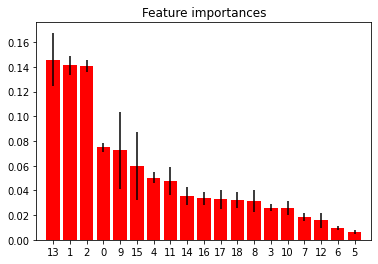

In [256]:
importances = rf.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Printing the feature ranking
print("Feature ranking:")

for f in range(X1.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plotting the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X1.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X1.shape[1]), indices)
plt.xlim([-1, X1.shape[1]])
plt.show()

Features 5, 6 and 12 have the lowest importance in our model whereas 13, 1 and 2 have the highest importance. Therefore, drop last two features and try our model again.

In [257]:
# Storing the features to be dropped

discard = ['public_meeting', 'permit']

# To determine our X,y values again according to new dataframe
used_cols2 = [c for c in df2.columns.tolist() if c not in [target] + discard]
X2, y2 = df2[used_cols2], df2[target]

In [258]:
# Setting classifier with best grid search parameters and taking roc-auc score

rf = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1,class_weight='balanced',
                        criterion ='entropy',max_features = 'sqrt', min_samples_split = 10)

scores = cross_val_score(rf, X2, y2, cv=5, scoring='roc_auc')
print(scores.mean(), "+/-", scores.std())

0.9239375269618346 +/- 0.002330903630378151


In [259]:
# Store this in the results dataframe
df_results = df_results.append({ 
     "Model": 'RFClassifier w/feature selection' ,
      "Scaler": 'Robust' , 
       'Encoder' : 'WoE',
                'roc_auc score mean' : 0.9242,
                    'roc_auc score std' : 0.0020}, ignore_index=True)

# Finding Best Important Features of Categorical Columns

To make feature selection and engineering in future, one can check the importance of categorical columns. Drop numeric columns and see our feature importance results again.

In [260]:
# Define numeric columns
num_col = ['gps_height','longitude','latitude','district_code','population','public_meeting','permit']

# Dropping numeric columns
X1.drop(columns=num_col,inplace=True ) 

In [261]:
#splitting data as train and test and fitting to model
X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.25, random_state=42)
rf.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', criterion='entropy',
                       max_features='sqrt', min_samples_split=10, n_jobs=-1,
                       random_state=42)

Feature ranking:
1. feature 6 (0.224535)
2. feature 2 (0.110666)
3. feature 8 (0.089681)
4. feature 1 (0.081182)
5. feature 4 (0.079445)
6. feature 9 (0.073505)
7. feature 10 (0.068037)
8. feature 11 (0.064931)
9. feature 7 (0.063736)
10. feature 0 (0.059052)
11. feature 3 (0.053127)
12. feature 5 (0.032103)


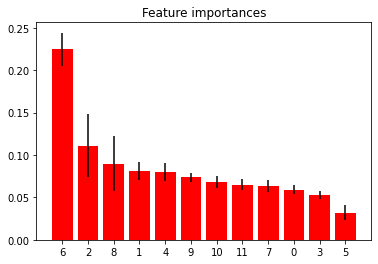

In [262]:
# looking at the importance 
importances = rf.feature_importances_
std = np.std([tree.feature_importances_ for tree in rf.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Printing the feature ranking
print("Feature ranking:")

for f in range(X1.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plotting the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X1.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X1.shape[1]), indices)
plt.xlim([-1, X1.shape[1]])
plt.show()

Categorical columns 6 has more importance then all others. It can give idea to us about feature engineering.

# k-Neigbours Classifier 


The general principle of k-Neighbors is to find closest in distance of the new point to predefined number of training points and predict the label according to this. First trying this model without any parameter tuning. According to result, I will decide to tune or leave this model.

In [263]:
knn = KNeighborsClassifier()

pipe = make_pipeline(preprocessor,knn)
scores = cross_val_score(pipe, X, y, cv=5, scoring='roc_auc')
print(scores.mean(), "+/-", scores.std())

0.8851187231060669 +/- 0.0024751372985418953


In [264]:
# Store this in the results dataframe
df_results = df_results.append({
     "Model": 'K-Neigbours' ,
      "Scaler": 'Robust' , 
       'Encoder' : 'WoE',
                'roc_auc score mean' : 0.8852,
                    'roc_auc score std' : 0.0024}, ignore_index=True)

This is not better than our Random Forest model. So, we leave it also and do not work on tuning the parameters.

# XGBClassifier


XGBoost is an efficient and flexiable classifier which implements models with Gradient Boosting. Although, it is very usefull classifier, it can be overfit easily. So, parameter selection is very imporant for XGBoost. We can do grid search also for XGBoost to tune our parameters but it takes too much time. So, again I played around our parameters manually and decided the best one.

In [265]:
# Making sure we will use correct dataframe we will set our X , y again

used_cols = [c for c in df1.columns.tolist() if c not in [target]]
X=df1[used_cols]
y=df1[target]

# Divide our X and y to test and train
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Accuracy:
TRAIN: 0.9401725589225589
TEST: 0.8636363636363636

Balanced Accuracy:
TRAIN: 0.9263970869491733
TEST: 0.8417503846501946


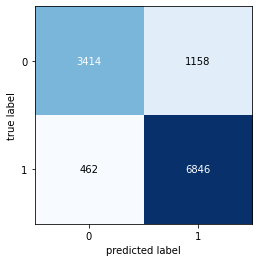

In [266]:
# Choosing model

xgb = XGBClassifier(objective = 'multi:softmax',num_class = 3, eta = .1,max_depth = 12, 
                    colsample_bytree = .4, learning_rate = 0.1)

pipe = make_pipeline(preprocessor,xgb)
pipe.fit(X_train, y_train)


# Make predictions on training set
y_pred = pipe.predict(X_train)

# Make predictions on test set
y_pred_test = pipe.predict(X_test)

# Print the 
print("Accuracy:"); print("="*len("Accuracy:"))
print(f"TRAIN: {accuracy_score(y_train, y_pred)}")
print(f"TEST: {accuracy_score(y_test, y_pred_test)}")

print("\nBalanced Accuracy:"); print("="*len("Balanced Accuracy:"))
print(f"TRAIN: {balanced_accuracy_score(y_train, y_pred)}")
print(f"TEST: {balanced_accuracy_score(y_test, y_pred_test)}")


cm = confusion_matrix(y_test, y_pred_test)
plot_confusion_matrix(cm)
plt.show()

We set these parameters according to results found. To compare our results and make sure about roc-auc score, run same model in cross validation.

In [267]:
pipe = make_pipeline(preprocessor,xgb)
scores = cross_val_score(pipe, X, y, cv=5, scoring='roc_auc')
print(scores.mean(), "+/-", scores.std())

0.8409234332626456 +/- 0.004092224395656548


In [268]:
# Store this in the results dataframe
df_results = df_results.append({ 
     "Model": 'XGBoost' ,
      "Scaler": 'Robust' , 
       'Encoder' : 'WoE',
                'roc_auc score mean' : 0.8407,
                    'roc_auc score std' : 0.0035}, ignore_index=True)

So far random forests will be our prefered model. It has the best perfomance so far.



# Comparing Results

In [269]:
df_results

,Model,Scaler,Encoder,roc_auc score mean,roc_auc score std
0,LogReg,Robust,TargetEncoder,0.8313,0.0041
1,LogReg,Robust,WeO,0.8318,0.0040
2,LogReg,Robust,OneHot,0.8538,0.0024
3,LogReg,MinMax,WoE,0.8317,0.0040
4,DecisionTreeClassifier,Robust,WoE,0.7864,0.0089
5,RandomForestClassifier,Robust,WoE,0.9193,0.0022
6,RFC with GridSearch,Robust,WoE,0.9243,0.0023
7,RFClassifier w/feature selection,Robust,WoE,0.9242,0.0020
8,K-Neigbours,Robust,WoE,0.8852,0.0024
9,XGBoost,Robust,WoE,0.8407,0.0035


According to the results dataframe, the best results for this binary problem is obtained with Random Forest Classifier with grid search. We can do more parameter tuning and better XGBoost model maybe. 

That will be enough for this step. Because the main problem is to build model with 3-class target. This all notebook gave idea us about what must be our steps for 3-class target.



# Best Decided Model for Binary Target

Accuracy:
TRAIN: 0.9518939393939394
TEST: 0.8608585858585859

Balanced Accuracy:
TRAIN: 0.947945248683256
TEST: 0.8476402734140991


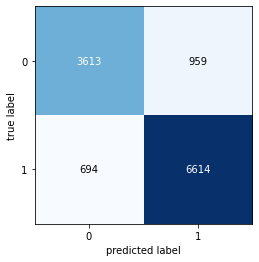

In [270]:
rf = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1,class_weight='balanced',
                            criterion = 'entropy',max_features = 'sqrt',min_samples_split = 10)
 
pipe = make_pipeline(preprocessor,rf)
pipe.fit(X_train, y_train)

# Predictions on train set
y_pred = pipe.predict(X_train)

# Predictions on test set
y_pred_test = pipe.predict(X_test)

print("Accuracy:"); print("="*len("Accuracy:"))
print(f"TRAIN: {accuracy_score(y_train, y_pred)}")
print(f"TEST: {accuracy_score(y_test, y_pred_test)}")

print("\nBalanced Accuracy:"); print("="*len("Balanced Accuracy:"))
print(f"TRAIN: {balanced_accuracy_score(y_train, y_pred)}")
print(f"TEST: {balanced_accuracy_score(y_test, y_pred_test)}")

# Confusion matrix
cm = confusion_matrix(y_test, y_pred_test)
plot_confusion_matrix(cm)
plt.show()

Prioritized the model based on roc-auc scores. I looked at the balanced accuracy for test set since the metric for competition is balanced accuracy. It is overfit, but still giving good test balanced accurancy results. So, we choose this model. XGBoost is not over fit and giving near results to this model. These are two good models in this project so far. 

According to confusion matrix on test data, there is no exact split but it is shown that we will care about 962 points which is already predicted as functional but normally they are non-functional. Also, 698 points are predicted as non-functional but they are functional. With the learnings from binary model, I will proceed to multi-class target model.


# Multi-Class Target Modeling

Good results with Random Forest Classifier in binary target. Now the main target is 3 classes. Models used previously will be applieed in a suitable format to three-class target.

I will model Random Forest and XGBoost. Also, smote technique is applied to imbalanced target data and created balanced data.

Balanced accuracy on test set will be a main focus. Because, competition metric for success in ternary classification problem is balaced accuracy.

In [272]:
# Importing the dataset
df = pd.read_csv('/content/eda_data.csv') 

# View all columns
pd.options.display.max_columns=100 

In [273]:
# Dropping unnecessary columns
df.drop(columns=['Unnamed: 0','funder','installer','construction_year'],inplace=True )

# df assigned another dataframe to protect original
df1= df.copy() 

In [274]:
# Dropping lga and ward which has same information with regions
df1.drop(columns=['lga','ward'],inplace=True ) 

In [275]:
# Converting from T/F to 0-1
df1['permit'] = df1['permit'].astype(bool).astype(int) 

# Converting from T/F to 0-1
df1['public_meeting'] = df1['public_meeting'].astype(bool).astype(int) 

In [276]:
# Assigning categorical columns
cat_column = ['basin','region','extraction_type_group','management','payment','water_quality','quantity',
               'source','waterpoint_type','decade','installer_cat','funder_cat']

# Assigning numeric columns
num_column = ['gps_height','longitude','latitude','district_code','population','public_meeting','permit']

In [277]:
df1['status_group'].value_counts()

0    32259
2    22824
1     4317
Name: status_group, dtype: int64

Our target labels again:

- 0 = functional 
- 1 = functional but needs repair
- 2 = non-functional

In [278]:
# Assign target
target='status_group'

In [279]:
# Seperate columns to X,y 
used_cols = [c for c in df1.columns.tolist() if c not in [target]]
X=df1[used_cols]
y=df1[target]

In [280]:
# Choosing train-test splits
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

Same as the binary models, we scaled numeric columns and encoded categorical columns. However, used TargetEncoder in this section because Weight of Evidence is not suitable for multiclass problems. 

In [281]:
# View all results
df_results = pd.DataFrame(columns=["Model", "test_balanced_acc",
                                   'train_balanced_acc', 'info']) 

# Random Forest

In [282]:
# Choosing scaler and encoder
scaler=RobustScaler()
encoder = ce.TargetEncoder(cols=cat_column)

# Assigning numeric columns to scaler and categorical to encoder
num_transformer = make_pipeline(scaler)
cat_transformer = make_pipeline(encoder)

# Getting our scaler and encoder together with preprocessor
preprocessor = ColumnTransformer(
      transformers=[('num', num_transformer, num_column),
                    ('cat', cat_transformer, cat_column)])

# Set rf with best grid search results

rf = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1,
                            criterion= 'entropy',max_features= 'sqrt',
                             min_samples_split= 10,class_weight='balanced')

# Giving all values to pipeline

pipe = make_pipeline(preprocessor,rf)
pipe.fit(X_train,y_train)

# Predictions on train set
y_pred = pipe.predict(X_train)

# Predictions on test set
y_pred_test = pipe.predict(X_test)

# Print the results
print("Accuracy:"); print("="*len("Accuracy:"))
print(f"TRAIN: {accuracy_score(y_train, y_pred)}")
print(f"TEST: {accuracy_score(y_test, y_pred_test)}")

print("\nBalanced Accuracy:"); print("="*len("Balanced Accuracy:"))
print(f"TRAIN: {balanced_accuracy_score(y_train, y_pred)}")
print(f"TEST: {balanced_accuracy_score(y_test, y_pred_test)}")

Accuracy:
TRAIN: 0.9199326599326599
TEST: 0.7896969696969697

Balanced Accuracy:
TRAIN: 0.9320869228847956
TEST: 0.7086854019151038


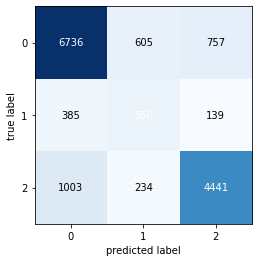

In [283]:
# Confusion matrix
cm = confusion_matrix(y_test, y_pred_test)
plot_confusion_matrix(cm)
plt.show()

Our 3-class dataframe does not fit well to the model. It is highly overfit. To handle the overfit I will try  and XGBoost.



In [284]:
# Store this in the results dataframe
df_results = df_results.append({ 
     "Model": 'RandomForest' ,
      "test_balanced_acc": 0.712 , 
       'train_balanced_acc' : 0.933,
               'info' : 'gridsearch best param'}, ignore_index=True)


# XGBoost

Accuracy:
TRAIN: 0.8457463524130191
TEST: 0.7995286195286195

Balanced Accuracy:
TRAIN: 0.6859775460655048
TEST: 0.6277471004793191


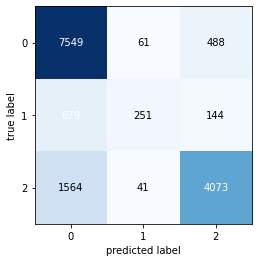

In [285]:
xgb = XGBClassifier(objective = 'multi:softmax', booster = 'gbtree',num_class = 3, eval_metric = 'merror',
                    eta = .1, max_depth = 10, colsample_bytree = .4, n_jobs = -1,learning_rate = 0.05)

pipe = make_pipeline(preprocessor,xgb)
pipe.fit(X_train, y_train)


# Make predictions on training set
y_pred = pipe.predict(X_train)

# Make predictions on test set
y_pred_test = pipe.predict(X_test)

# Print the results
print("Accuracy:"); print("="*len("Accuracy:"))
print(f"TRAIN: {accuracy_score(y_train, y_pred)}")
print(f"TEST: {accuracy_score(y_test, y_pred_test)}")

print("\nBalanced Accuracy:"); print("="*len("Balanced Accuracy:"))
print(f"TRAIN: {balanced_accuracy_score(y_train, y_pred)}")
print(f"TEST: {balanced_accuracy_score(y_test, y_pred_test)}")

# Confusion matrix
cm = confusion_matrix(y_test, y_pred_test)
plot_confusion_matrix(cm)
plt.show()

XGBoost gave overfit results. With playing around parameters got closer the train- test balanced accuracy results, but stil it is overfit and there are big difference between accuracy and balanced accuracy. Also, 63% is very low. From this information, I understood that we need to solve our imbalanced class problem. To do this, there are some ways. We can set class weight as balanced in Random Forest which we have already done.

The other common solution is to resampling imbalanced data. There are two main ways; over-sampling and under-sampling. One of the labels is really insufficient. So, I will use over sampling technique. It tries to balance target with increasing the number of the rare samples. To protect our data from abundant samples, new rare samples must be generated by using techniques as repetition, bootstrapping or SMOTE (Synthetic Minority Over-Sampling Technique).

In [286]:
# Store this in the results dataframe
df_results = df_results.append({ 
     "Model": 'XGBoost' ,
      "test_balanced_acc": 0.629 , 
       'train_balanced_acc' : 0.682,
               'info' : ''}, ignore_index=True)


# SMOTE

To use SMOTE with scaler and encoder takes too much time. So, we will encode and scale our dataframe and change it. To protect the original one, we assign it to new df.

In [287]:
# importing necessary libraries
from imblearn.over_sampling import SMOTE
from sklearn import preprocessing

In [288]:
# Assigning a new dataframe
df4=df1.copy()  

In [289]:
# Encoding categorical columns
encoder = TargetEncoder()

for c in cat_column:
    df4[str(c) + '_encoded'] = encoder.fit_transform(df4[c].values, df4[target])
    df4.drop(columns=c, inplace=True) 

In [290]:
# Scaling numerical columns

scaler = preprocessing.RobustScaler()


def scaleColumns(df, num_column):
    for col in num_column:
        df[col] = pd.DataFrame(scaler.fit_transform(pd.DataFrame(df4[col])),columns=[col])
    return df

scaled_df = scaleColumns(df4,[num_column])


In [291]:
# assign X and y
used_cols = [c for c in scaled_df.columns.tolist() if c not in [target]]
X=scaled_df[used_cols]
y=scaled_df[target]

In [292]:
# Making over-sampling 

smt = SMOTE(sampling_strategy = 'auto', n_jobs = -1)

X_sampled, y_sample = smt.fit_resample(X, y)

print(y.value_counts())

y_sampled = pd.Series(y_sample) # converting from array to np.series to see value_counts

print(y_sampled.value_counts())

0    32259
2    22824
1     4317
Name: status_group, dtype: int64
0    32259
2    32259
1    32259
Name: status_group, dtype: int64


It made our target balanced with taking random samples.

In [293]:
# Splitting train-test balanced target data
X_train, X_test, y_train, y_test = train_test_split(X_sampled, y_sampled, test_size=0.25, random_state=42)

In [294]:
# Setting classifier
xgb_smote = XGBClassifier(objective = 'multi:softmax', booster = 'gbtree',num_class = 3,
                          eval_metric = 'merror', eta = .1,max_depth = 16, colsample_bytree = .4, 
                          n_jobs = -1,learning_rate = 0.1)


xgb_smote.fit(X_train, y_train)


# Predictions of training set
y_pred = xgb_smote.predict(X_train)

# Predictions of test set
y_pred_test = xgb_smote.predict(X_test)

# Print the results
print("Accuracy:"); print("="*len("Accuracy:"))
print(f"TRAIN: {accuracy_score(y_train, y_pred)}")
print(f"TEST: {accuracy_score(y_test, y_pred_test)}")

print("\nBalanced Accuracy:"); print("="*len("Balanced Accuracy:"))
print(f"TRAIN: {balanced_accuracy_score(y_train, y_pred)}")
print(f"TEST: {balanced_accuracy_score(y_test, y_pred_test)}")

Accuracy:
TRAIN: 0.9714254222810063
TEST: 0.8616656333953296

Balanced Accuracy:
TRAIN: 0.9714251322542053
TEST: 0.8616795932565863


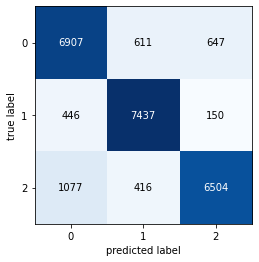

In [295]:
# Confusion matrix
cm = confusion_matrix(y_test, y_pred_test)
plot_confusion_matrix(cm)
plt.show()


In [296]:
# Store this in the results dataframe
df_results = df_results.append({ 
     "Model": 'XGBoost' ,
      "test_balanced_acc": 0.860 , 
       'train_balanced_acc' : 0.952,
               'info' : 'with SMOTE'}, ignore_index=True)

With smote, we found best test balanced accuracy. 86% is a enough good result for the first submission. From the confusion matrix, it is seen that splits are clear but not exact. We will work on overfitting problem more with tuning the parametes as future plan. Our aim for confusion matrix is to balance false positive and false negatives. Because, if our model predicts wells as non-functional which normally are functional, it will create problem for business solutions. Or, if our prediction is functional but normally well is non-functional, it also creates problem. So, tried balancing our false predictions.



# Comparing Results

In [297]:
df_results

,Model,test_balanced_acc,train_balanced_acc,info
0,RandomForest,0.712,0.933,gridsearch best param
1,XGBoost,0.629,0.682,
2,XGBoost,0.860,0.952,with SMOTE


All of these 3 models, XGBoost is best when we use it with SMOTE. So, our new and decided model is XGBoost with SMOTE. With 86% accuracy, we can predict the functionality of the wells.



# Evaluation


- Generally higher population areas has higher number of functional wells.
- Some areas have higher probability to find clean water especially, if they are near good basins.
- Dar es Salaam is one of the highest populated cities but 35% of good water quality points are non-functional.
- Iringa is one of the important areas but it contains lots of non-functional wateer points which has soft water.
- Mostly the wells which are funded by government are non-functional.
- Most of water points which central government and district council installed are non-functional.
- The most common extraction type is gravity but second is hand pumps. The efficiency of handpumps is less than commercial pumps. This shows that authorities need to focus on pumping type. It is seen that, there are many non-functional water points which belongs to gravity as extraction type.
- Some water points that have enough and soft water are non-function.
- The wells that were constructed in recent years are more functional than older ones. It is evident that recent wells have better functionality but needs repair sooner or later. 
- There are lots of water wells which has enough water are non-functional. 




## Findings

- 4272 wells were dried but they have good water quality. With a sound solution, these wells can be functional. Finding clean water sources is not the only problem, to continue to feed these sources are equaly important.
- 2226 (7%) wells have enough and soft water but need repair. Authorities must invest on repairing. Otherwise these will be non-functional.
- 8035 (27%) wells has enough, good quality water but they are non-functional. This shows that authorities must work and invest on technology to pump these good sources.
- Authorties should check again the wells which they funded.
- New tecqniques must be found to feed dry wells and repair wells.


For the predictions, I made models for both binary and multiclass targets. According to the results dataframe, the best results for this binary class target was obtained with Random Forest Classifier with grid search. The table belo shows the results for he binary class tartget models:

![binary.jpg](./images/binary.jpg)


Prioritized random forest model based on roc-auc scores. I looked at the balanced accuracy for test set since the metric for competition is balanced accuracy. It is overfit, but still giving good test balanced accurancy results. So, I choose this model. XGBoost is not over fit and giving near results to this model. These are two good models in the project.

According to confusion matrix on test data, there is no exact split but it is shown that we will care about 962 points which is already predicted as functional but normally they are non-functional. Also, 698 points are predicted as non-functional but they are functional. With the learnings from binary model, I proceeded to multi-class target model.

All of the 3 models I implemented, XGBoost performed best when we used it with SMOTE. So, our new and decided model is XGBoost with SMOTE. With 86% accuracy, we can predict the functionality of the wells. Below is a summary of the results of multiclass target models:

![multi.jpg](./images/multi.jpg)



With smote, we found best test balanced accuracy. 86% is a enough good result for the first submission. From the confusion matrix, it is seen that splits are clear but not exact. We will work on overfitting problem more with tuning the parametes as future plan. Our aim for confusion matrix is to balance false positive and false negatives. Because, if our model predicts wells as non-functional which normally are functional, it will create problem for business solutions. Or, if our prediction is functional but normally well is non-functional, it also creates problem. So, tried balancing our false predictions.

# Conclusion

PRIORITIZE EFFECIENTLY: The following criteria should be observred to achieve this.

**Repairs:**
- Prioritize functioning wells which need repair and yield clean water.

**Funding**
- Allocate funds and resources to effective organizations with track record.

**Payment**
- Payments of some kind will provide incentive to keep wells functional. Pick a metric and charge per unit.

**Location**
- Target repairs to clusters of wells especially those with high populations.


Our Model is 86% Accurate therefore I am confident if more is done with less then funds are used efficiently and effectively. There is need to streamline maintenance and repairs

# Recommendations

**MONITOR WELLS**
- Update model regularly to issue preventative maintenance.

**GEOGRAPHIC REGION**
- Model has to consider regional actors: rainfall, climate, geology,etc.

**IMPROVE DATA**
- Quantify qualitative data to improve model.


# APPENDIX

## MAPS

In [313]:
# import librarties
import numpy as np
import pandas as pd 
import matplotlib.cm


import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
import folium
from folium.plugins import HeatMap
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [314]:
df=pd.read_csv('/content/eda_data.csv')
df1=pd.read_csv('/content/training_set_labels.csv')
df['status_group']=df1['status_group']
df

,Unnamed: 0,funder,gps_height,installer,longitude,latitude,basin,region,district_code,lga,ward,population,public_meeting,permit,construction_year,extraction_type_group,management,payment,water_quality,quantity,source,waterpoint_type,status_group,decade,installer_cat,funder_cat
0,0,Roman,1390,Roman,34.938093,-9.856322,Lake Nyasa,Iringa,5,Ludewa,Mundindi,109,True,False,1999,gravity,vwc,pay annually,soft,enough,spring,communal standpipe,functional,90s,Others,Others
1,1,Grumeti,1399,GRUMETI,34.698766,-2.147466,Lake Victoria,Mara,2,Serengeti,Natta,280,True,True,2010,gravity,wug,never pay,soft,insufficient,rainwater harvesting,communal standpipe,functional,10s,Others,Others
2,2,Lottery Club,686,world vision,37.460664,-3.821329,Pangani,Manyara,4,Simanjiro,Ngorika,250,True,True,2009,gravity,vwc,pay per bucket,soft,enough,dam,communal standpipe multiple,functional,00s,world vision,Others
3,3,Unicef,263,Unicef,38.486161,-11.155298,Ruvuma / Southern Coast,Mtwara,63,Nanyumbu,Nanyumbu,58,True,True,1986,submersible,vwc,never pay,soft,dry,machine dbh,communal standpipe multiple,non functional,80s,Others,Unicef
4,4,Action In A,0,Artisan,31.130847,-1.825359,Lake Victoria,Kagera,1,Karagwe,Nyakasimbi,281,True,True,2000,gravity,other,never pay,soft,seasonal,rainwater harvesting,communal standpipe,functional,0,Others,Others
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59395,59395,Germany Republi,1210,CES,37.169807,-3.253847,Pangani,Kilimanjaro,5,Hai,Masama Magharibi,125,True,True,1999,gravity,water board,pay per bucket,soft,enough,spring,communal standpipe,functional,90s,Others,Germany Republi
59396,59396,Cefa-njombe,1212,Cefa,35.249991,-9.070629,Rufiji,Iringa,4,Njombe,Ikondo,56,True,True,1996,gravity,vwc,pay annually,soft,enough,river,communal standpipe,functional,90s,Others,Others
59397,59397,Unknown,0,Unknown,34.017087,-8.750434,Rufiji,Mbeya,7,Mbarali,Chimala,281,True,False,2000,swn 80,vwc,pay monthly,fluoride,enough,machine dbh,hand pump,functional,0,Unknown,Unknown
59398,59398,Malec,0,Musa,35.861315,-6.378573,Rufiji,Dodoma,4,Chamwino,Mvumi Makulu,281,True,True,2000,nira/tanira,vwc,never pay,soft,insufficient,shallow well,hand pump,functional,0,Others,Others


In [315]:
df['status_color']=df['status_group'].replace('functional','green').replace('non functional','red').replace('functional needs repair', 'yellow')
df

,Unnamed: 0,funder,gps_height,installer,longitude,latitude,basin,region,district_code,lga,ward,population,public_meeting,permit,construction_year,extraction_type_group,management,payment,water_quality,quantity,source,waterpoint_type,status_group,decade,installer_cat,funder_cat,status_color
0,0,Roman,1390,Roman,34.938093,-9.856322,Lake Nyasa,Iringa,5,Ludewa,Mundindi,109,True,False,1999,gravity,vwc,pay annually,soft,enough,spring,communal standpipe,functional,90s,Others,Others,green
1,1,Grumeti,1399,GRUMETI,34.698766,-2.147466,Lake Victoria,Mara,2,Serengeti,Natta,280,True,True,2010,gravity,wug,never pay,soft,insufficient,rainwater harvesting,communal standpipe,functional,10s,Others,Others,green
2,2,Lottery Club,686,world vision,37.460664,-3.821329,Pangani,Manyara,4,Simanjiro,Ngorika,250,True,True,2009,gravity,vwc,pay per bucket,soft,enough,dam,communal standpipe multiple,functional,00s,world vision,Others,green
3,3,Unicef,263,Unicef,38.486161,-11.155298,Ruvuma / Southern Coast,Mtwara,63,Nanyumbu,Nanyumbu,58,True,True,1986,submersible,vwc,never pay,soft,dry,machine dbh,communal standpipe multiple,non functional,80s,Others,Unicef,red
4,4,Action In A,0,Artisan,31.130847,-1.825359,Lake Victoria,Kagera,1,Karagwe,Nyakasimbi,281,True,True,2000,gravity,other,never pay,soft,seasonal,rainwater harvesting,communal standpipe,functional,0,Others,Others,green
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59395,59395,Germany Republi,1210,CES,37.169807,-3.253847,Pangani,Kilimanjaro,5,Hai,Masama Magharibi,125,True,True,1999,gravity,water board,pay per bucket,soft,enough,spring,communal standpipe,functional,90s,Others,Germany Republi,green
59396,59396,Cefa-njombe,1212,Cefa,35.249991,-9.070629,Rufiji,Iringa,4,Njombe,Ikondo,56,True,True,1996,gravity,vwc,pay annually,soft,enough,river,communal standpipe,functional,90s,Others,Others,green
59397,59397,Unknown,0,Unknown,34.017087,-8.750434,Rufiji,Mbeya,7,Mbarali,Chimala,281,True,False,2000,swn 80,vwc,pay monthly,fluoride,enough,machine dbh,hand pump,functional,0,Unknown,Unknown,green
59398,59398,Malec,0,Musa,35.861315,-6.378573,Rufiji,Dodoma,4,Chamwino,Mvumi Makulu,281,True,True,2000,nira/tanira,vwc,never pay,soft,insufficient,shallow well,hand pump,functional,0,Others,Others,green


In [316]:
# Map
m=folium.Map(location=[df['latitude'].mean(),df['longitude'].mean()], tiles='Stamen Terrain',zoom_start=5.5)

for index, row in df.iterrows():
    folium.Circle([row['latitude'], row['longitude']],
                    radius=15, color=row['status_color']).add_to(m)
    
m

In [317]:
df_yellow=df.where(df['status_color']=='yellow')
df_yellow.dropna(inplace=True)
df_yellow

,Unnamed: 0,funder,gps_height,installer,longitude,latitude,basin,region,district_code,lga,ward,population,public_meeting,permit,construction_year,extraction_type_group,management,payment,water_quality,quantity,source,waterpoint_type,status_group,decade,installer_cat,funder_cat,status_color
18,18.0,Hesawa,1162.0,DWE,32.920154,-1.947868,Lake Victoria,Mwanza,1.0,Ukerewe,Ilangala,1000.0,True,True,1999.0,other,vwc,never pay,milky,insufficient,spring,other,functional needs repair,90s,DWE,Hesawa,yellow
22,22.0,Unicef,1510.0,DWE,34.586901,-8.980014,Rufiji,Iringa,4.0,Njombe,Usuka,350.0,True,True,1978.0,gravity,wua,never pay,soft,enough,river,communal standpipe,functional needs repair,70s,DWE,Unicef,yellow
25,25.0,Government Of Tanzania,1273.0,DWE,37.422751,-3.317536,Pangani,Kilimanjaro,4.0,Moshi Rural,Kimochi,140.0,True,True,1974.0,gravity,vwc,unknown,soft,enough,spring,communal standpipe,functional needs repair,70s,DWE,Government Of Tanzania,yellow
32,32.0,Government Of Tanzania,1481.0,DWE,37.492334,-3.290627,Pangani,Kilimanjaro,4.0,Moshi Rural,Kilema Kati,180.0,False,True,1972.0,gravity,other,never pay,soft,insufficient,river,other,functional needs repair,70s,DWE,Government Of Tanzania,yellow
44,44.0,Government Of Tanzania,1007.0,DWE,36.806079,-3.478559,Pangani,Arusha,2.0,Arusha Rural,Nduruma,100.0,True,True,2000.0,gravity,vwc,pay per bucket,soft,insufficient,spring,communal standpipe,functional needs repair,00s,DWE,Government Of Tanzania,yellow
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59322,59322.0,Unicef,532.0,Unicef,36.985457,-11.467225,Ruvuma / Southern Coast,Ruvuma,1.0,Tunduru,Nalasi,1.0,True,False,1999.0,swn 80,vwc,pay annually,soft,enough,machine dbh,hand pump,functional needs repair,90s,Others,Unicef,yellow
59328,59328.0,Tcrs,1497.0,TCRS,34.799452,-4.349604,Internal,Singida,1.0,Iramba,Ilunda,195.0,True,True,1997.0,nira/tanira,vwc,pay when scheme fails,soft,enough,shallow well,hand pump,functional needs repair,90s,TCRS,Tcrs,yellow
59333,59333.0,Kiuma,706.0,KIUMA,36.961390,-11.305345,Ruvuma / Southern Coast,Ruvuma,1.0,Tunduru,Marumba,1.0,True,False,2011.0,submersible,vwc,pay per bucket,soft,enough,machine dbh,communal standpipe multiple,functional needs repair,10s,Others,Others,yellow
59345,59345.0,Isf,962.0,DWE,29.729909,-4.801508,Lake Tanganyika,Kigoma,3.0,Kigoma Rural,Mahembe,500.0,True,True,2008.0,gravity,vwc,pay monthly,soft,enough,river,communal standpipe multiple,functional needs repair,00s,DWE,Others,yellow


In [312]:
# Map
m_needs_repair=folium.Map(location=[df['latitude'].mean(),df['longitude'].mean()], tiles='Stamen Terrain',zoom_start=5.5)

for index, row in df_yellow.iterrows():
    folium.Circle([row['latitude'], row['longitude']],
                    radius=15, color=row['status_color']).add_to(m_needs_repair)
    
m_needs_repair

In [308]:
df_red=df.where(df['status_color']=='red')
df_red.dropna(inplace=True)
df_red

,Unnamed: 0,funder,gps_height,installer,longitude,latitude,basin,region,district_code,lga,ward,population,public_meeting,permit,construction_year,extraction_type_group,management,payment,water_quality,quantity,source,waterpoint_type,status_group,decade,installer_cat,funder_cat,status_color
3,3.0,Unicef,263.0,Unicef,38.486161,-11.155298,Ruvuma / Southern Coast,Mtwara,63.0,Nanyumbu,Nanyumbu,58.0,True,True,1986.0,submersible,vwc,never pay,soft,dry,machine dbh,communal standpipe multiple,non functional,80s,Others,Unicef,red
6,6.0,Dwsp,0.0,DWSP,33.362410,-3.766365,Internal,Shinyanga,3.0,Shinyanga Rural,Samuye,281.0,True,True,2000.0,swn 80,vwc,never pay,soft,enough,machine dbh,hand pump,non functional,0,Others,Dwsp,red
7,7.0,Rwssp,0.0,DWE,32.620617,-4.226198,Lake Tanganyika,Shinyanga,3.0,Kahama,Chambo,281.0,True,True,2000.0,nira/tanira,wug,unknown,milky,enough,shallow well,hand pump,non functional,0,DWE,Rwssp,red
8,8.0,Wateraid,0.0,Water Aid,32.711100,-5.146712,Lake Tanganyika,Tabora,6.0,Tabora Urban,Itetemia,281.0,True,True,2000.0,india mark ii,vwc,never pay,salty,seasonal,machine dbh,hand pump,non functional,0,Others,Others,red
16,16.0,Unicef,1703.0,DWE,34.642439,-9.106185,Rufiji,Iringa,4.0,Njombe,Mdandu,35.0,True,True,1978.0,gravity,wua,pay monthly,soft,dry,river,communal standpipe,non functional,70s,DWE,Unicef,red
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59382,59382.0,Ces(gmbh),1383.0,DWE,37.454759,-3.323599,Pangani,Kilimanjaro,4.0,Moshi Rural,Kirua Vunjo Kusini,1.0,True,True,2008.0,gravity,water board,pay per bucket,soft,enough,spring,communal standpipe,non functional,00s,DWE,Others,red
59384,59384.0,Concern,0.0,CONCERN,30.667805,-2.483710,Lake Victoria,Kagera,30.0,Ngara,Nyamiyaga,281.0,True,False,2000.0,gravity,vwc,never pay,soft,insufficient,spring,communal standpipe,non functional,0,Others,Others,red
59391,59391.0,Government Of Tanzania,540.0,Government,38.044070,-4.272218,Pangani,Kilimanjaro,3.0,Same,Maore,210.0,True,True,1967.0,gravity,vwc,never pay,soft,enough,river,communal standpipe,non functional,60s,Government,Government Of Tanzania,red
59392,59392.0,Government Of Tanzania,0.0,Government,33.009440,-8.520888,Lake Rukwa,Mbeya,1.0,Chunya,Mbuyuni,281.0,True,True,2000.0,gravity,vwc,never pay,soft,enough,spring,communal standpipe,non functional,0,Government,Government Of Tanzania,red


In [309]:
# Map
m_non_func=folium.Map(location=[df['latitude'].mean(),df['longitude'].mean()], tiles='Stamen Terrain',zoom_start=5.5)

for index, row in df_red.iterrows():
    folium.Circle([row['latitude'], row['longitude']],
                    radius=15, color=row['status_color']).add_to(m_non_func)

    
m_non_func